In [1]:
import re
import numpy as np
import pandas as pd
pd.set_option('max_colwidth',50)
pd.set_option('max_columns',250)
pd.set_option('max_rows',500)

#visualizations
import folium
from folium import plugins
from folium.plugins import HeatMap
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns 
import cufflinks as cf
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools as tls
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
from mpl_toolkits.basemap import Basemap
%matplotlib inline 
cf.go_offline()
cf.set_config_file(world_readable=True,theme='white') # Make all charts public and set a global theme
sns.set_style("whitegrid") #possible choices: white, dark, whitegrid, darkgrid, ticks

from functions import *

### Dataframes that will be used
<img src="imgs/dataframes_visually.png"/>

# Engraulis Encrasicolus

|    | Scientific name          | Common_name_GRE | Common_name_ENG        | Habitat       | Depth range (m) | Usual depth range (m) |
|----|--------------------------|-----------------|------------------------|---------------|-----------------|-----------------------|
|   | Engraulis encrasicolus	| Γαύρος         | European anchovy        | Pelagic       | 0-400          | 0-200                |
<img src="imgs/engraulis.jpg" alt="Sardina pilchardus" width="200px" align="center"/>

In [2]:
species = 'Engraulis encrasicolus'
speciesName = 'Engraulis Encrasicolus'
# panel data
data_panel = pd.read_csv('T:/ownCloud/ODYSSEA/Aquamaps/the16species_final/'+species+'.csv',index_col='Unnamed: 0')
# fill missing values with interpolation
data_panel = data_panel.interpolate()
print(data_panel.shape[0], 'rows')

87480 rows


In [3]:
data_panel.head()

,id,Genus,Species,Center Lat,Center Long,C-Square Code,Overall Probability,obs_id,temperatureSurface,year_month,temperature100_300,temperature300_400,temperature100_500,temperatureMaxDepth,salinitySurface,salinity100_300,salinity300_400,salinity100_500,salinityMaxDepth,dissolvedOxygenSurface,dissolvedOxygen100_300,dissolvedOxygen300_400,dissolvedOxygen100_500,dissolvedOxygenMaxDepth,meridionalCurrentSurface,meridionalCurrent100_300,meridionalCurrent300_400,meridionalCurrent100_500,meridionalCurrentMaxDepth,zonalCurrentSurface,zonalCurrent100_300,zonalCurrent300_400,zonalCurrent100_500,zonalCurrentMaxDepth,chlorophyll,euphoticDepth,secchiDiskDepth,wave_Height,nitrateSurface,nitrate100_300,nitrate300_400,nitrate100_500,nitrateMaxDepth,phosphateSurface,phosphate100_300,phosphate300_400,phosphate100_500,phosphateMaxDepth,distanceToCoast,majorRiverDistance,majorRiversScale,bathymetry,substrateType,substrateOrigHabitat,substrateBiozone
0,82008-01,Engraulis,encrasicolus,33.75,14.25,1301:134:3,0.18,8,17.725815,2008-01,13.844490,13.507731,13.459515,13.459515,38.087940,38.815998,38.776684,38.771378,38.771378,213.56018,197.90698,195.66885,195.70103,195.70103,0.090158,0.000276,-0.001963,0.009131,0.009131,0.025575,0.030393,-0.007791,-0.012931,-0.012931,0.118416,-0.584615,21.205545,1.225227,0.038598,3.533569,3.869514,3.865966,3.865966,0.011305,0.149524,0.156978,0.156905,0.156905,112.320279,798.607822,9,-558.406006,Muddy sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral
1,82008-02,Engraulis,encrasicolus,33.75,14.25,1301:134:3,0.18,8,16.585863,2008-02,13.878488,13.628418,13.659529,13.659529,38.015812,38.818150,38.791885,38.795517,38.795517,219.30383,196.48317,195.51575,195.30698,195.30698,0.000000,0.000276,-0.001963,0.009131,0.000000,0.000000,0.030393,-0.007791,-0.012931,0.000000,0.086341,-0.702502,22.987247,0.468116,0.060548,3.690489,3.838042,3.837302,3.837302,0.014088,0.152878,0.156209,0.156100,0.156100,112.320279,798.607822,9,-558.406006,Muddy sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral
2,82008-03,Engraulis,encrasicolus,33.75,14.25,1301:134:3,0.18,8,16.816313,2008-03,13.929226,13.721645,13.728916,13.728916,38.202360,38.821070,38.803510,38.804123,38.804123,220.26952,196.14700,195.89432,195.74548,195.74548,0.097831,0.000644,-0.007755,0.007424,0.007424,0.062373,0.035561,-0.007168,-0.009592,-0.009592,0.074114,-0.813037,23.942530,0.209489,0.019607,3.805410,3.775198,3.830252,3.830252,0.010501,0.155681,0.154727,0.156027,0.156027,112.320279,798.607822,9,-558.406006,Muddy sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral
3,82008-04,Engraulis,encrasicolus,33.75,14.25,1301:134:3,0.18,8,17.481320,2008-04,13.834653,13.641011,13.603822,13.603822,38.140490,38.814083,38.797382,38.792324,38.792324,221.19627,197.05533,196.59209,196.21631,196.21631,0.024131,0.000263,0.001049,0.007045,0.007045,-0.033241,0.053696,-0.005305,-0.008706,-0.008706,0.050782,-0.885562,27.410673,1.530199,0.005150,3.732387,3.689414,3.769975,3.769975,0.005833,0.154453,0.152723,0.154601,0.154601,112.320279,798.607822,9,-558.406006,Muddy sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral
4,82008-05,Engraulis,encrasicolus,33.75,14.25,1301:134:3,0.18,8,19.767954,2008-05,13.755164,13.660736,13.640566,13.640566,38.092026,38.809692,38.799380,38.797455,38.797455,213.95381,197.08623,196.00842,195.99338,195.99338,0.086533,0.000699,0.003216,0.020014,0.020014,0.032143,0.053266,-0.012838,-0.014712,-0.014712,0.035056,-1.068467,33.005775,0.798579,0.008064,3.683277,3.777598,3.818513,3.818513,0.005832,0.153109,0.154732,0.155804,0.155804,112.320279,798.607822,9,-558.406006,Muddy sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral


In [4]:
### Create some lists that will be useful
static_cols = ['distanceToCoast','majorRiverDistance', 'majorRiversScale', 'bathymetry', 'substrateType','substrateOrigHabitat', 'substrateBiozone']
temporal_cols = ['temperatureSurface','temperature100_300', 'temperature300_400', 'temperature100_500','temperatureMaxDepth', 'salinitySurface', 'salinity100_300','salinity300_400', 'salinity100_500', 'salinityMaxDepth','dissolvedOxygenSurface', 'dissolvedOxygen100_300','dissolvedOxygen300_400', 'dissolvedOxygen100_500','dissolvedOxygenMaxDepth', 'meridionalCurrentSurface','meridionalCurrent100_300', 'meridionalCurrent300_400','meridionalCurrent100_500', 'meridionalCurrentMaxDepth',
                 'zonalCurrentSurface', 'zonalCurrent100_300', 'zonalCurrent300_400','zonalCurrent100_500', 'zonalCurrentMaxDepth', 'chlorophyll','euphoticDepth', 'secchiDiskDepth', 'wave_Height', 'nitrateSurface','nitrate100_300', 'nitrate300_400', 'nitrate100_500', 'nitrateMaxDepth','phosphateSurface', 'phosphate100_300', 'phosphate300_400','phosphate100_500', 'phosphateMaxDepth']

### Create a new dataset with the mean value of each observation. This is the mean of 120 months.
data = pd.DataFrame()
for c in data_panel.columns:
    if c in temporal_cols:
        data[c] = data_panel.groupby('obs_id')[c].mean()
        #data[c+'_mean'] = data_panel.groupby('obs_id')[c].mean()
    if c in static_cols:
        data[c] = data_panel.groupby('obs_id')[c].agg(lambda x:x.value_counts().index[0])
    if c in ['Center Lat','Center Long','Overall Probability']:
        data[c] = data_panel.groupby('obs_id')[c].agg(lambda x:x.value_counts().index[0])
        
data_panel['year_month'] = pd.to_datetime(data_panel['year_month'])
data_panel['year'] = data_panel['year_month'].dt.year
data_panel['month'] = data_panel['year_month'].dt.month

### Group each year_month, so create a time series for the mean of all the observations
data_perYearMonth = pd.DataFrame()
for c in data_panel.columns:
    if c in temporal_cols:
        data_perYearMonth[c] = data_panel.groupby(['year_month'])[c].mean()
    if c in static_cols:
        data_perYearMonth[c] = data_panel.groupby(['year_month'])[c].agg(lambda x:x.value_counts().index[0])
    if c in ['Center Lat','Center Long']:
        data_perYearMonth[c] = data_panel.groupby(['year_month'])[c].agg(lambda x:x.value_counts().index[0])
data_perYearMonth = data_perYearMonth.reset_index()
data_perYearMonth['year_month'] = pd.to_datetime(data_perYearMonth['year_month'])
data_perYearMonth['year'] = data_perYearMonth['year_month'].dt.year
data_perYearMonth['month'] = data_perYearMonth['year_month'].dt.month 
data_perYearMonth = data_perYearMonth.set_index('year_month')

### Group by each observation and each year. For example for obs 1 and year 2008, for obs 1 and year 2009 .. for obs 595 and year 2017
data_perYear = pd.DataFrame()
for c in data_panel.columns:
    if c in temporal_cols:
        data_perYear[c] = data_panel.groupby(['obs_id','year'])[c].mean()
    if c in static_cols:
        data_perYear[c] = data_panel.groupby(['obs_id','year'])[c].agg(lambda x:x.value_counts().index[0])
    if c in ['Center Lat','Center Long']:
        data_perYear[c] = data_panel.groupby(['obs_id','year'])[c].agg(lambda x:x.value_counts().index[0])

### Group by each observation and each month. For example for obs 1 and month 1, for obs 1 and month 2 .. for obs 595 and month 12
data_perMonth = pd.DataFrame()
for c in data_panel.columns:
    if c in temporal_cols:
        data_perMonth[c] = data_panel.groupby(['obs_id','month'])[c].mean()
    if c in static_cols:
        data_perMonth[c] = data_panel.groupby(['obs_id','month'])[c].agg(lambda x:x.value_counts().index[0])
    if c in ['Center Lat','Center Long']:
        data_perMonth[c] = data_panel.groupby(['obs_id','month'])[c].agg(lambda x:x.value_counts().index[0])
        
data_panel.head()        
        
pelagic = [data]
pelagic_name = [speciesName]

In [5]:
print(data.shape[0], 'rows and ', data.shape[1], 'columns')
data.head()

729 rows and  49 columns


,Center Lat,Center Long,Overall Probability,temperatureSurface,temperature100_300,temperature300_400,temperature100_500,temperatureMaxDepth,salinitySurface,salinity100_300,salinity300_400,salinity100_500,salinityMaxDepth,dissolvedOxygenSurface,dissolvedOxygen100_300,dissolvedOxygen300_400,dissolvedOxygen100_500,dissolvedOxygenMaxDepth,meridionalCurrentSurface,meridionalCurrent100_300,meridionalCurrent300_400,meridionalCurrent100_500,meridionalCurrentMaxDepth,zonalCurrentSurface,zonalCurrent100_300,zonalCurrent300_400,zonalCurrent100_500,zonalCurrentMaxDepth,chlorophyll,euphoticDepth,secchiDiskDepth,wave_Height,nitrateSurface,nitrate100_300,nitrate300_400,nitrate100_500,nitrateMaxDepth,phosphateSurface,phosphate100_300,phosphate300_400,phosphate100_500,phosphateMaxDepth,distanceToCoast,majorRiverDistance,majorRiversScale,bathymetry,substrateType,substrateOrigHabitat,substrateBiozone
obs_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
8,33.75,14.25,0.18,21.997891,14.192421,13.997035,13.873049,13.873049,38.341779,38.862835,38.855492,38.844869,38.844869,202.826608,200.137110,199.354631,200.243749,200.243749,0.051221,0.000260,0.000461,0.006232,0.005909,-0.002450,0.028894,-0.002302,-0.006247,-0.005862,0.066673,-0.956098,29.703343,1.091948,0.024354,3.251982,3.324855,3.483949,3.483949,0.007697,0.145829,0.146385,0.150259,0.150259,112.320279,798.607822,9,-558.406006,Muddy sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral
9,34.75,10.25,0.02,21.541805,21.473048,21.473048,21.473048,21.473048,38.226371,38.225362,38.225362,38.225362,38.225362,204.957780,204.898634,204.898180,204.898180,204.898180,-0.000710,-0.002033,-0.002033,-0.002033,-0.001897,-0.004489,0.000115,0.000115,0.000115,0.000243,1.572421,0.252015,4.488641,0.487575,0.316209,0.331289,0.331280,0.331280,0.331280,0.018650,0.019260,0.019267,0.019267,0.019267,33.113671,806.500862,9,-4.390920,Sandy mud,A5.33: Infralittoral sandy mud,Infralittoral
10,34.75,14.25,0.15,21.685042,14.229790,14.015022,14.015022,14.015022,38.221759,38.862879,38.866231,38.866231,38.866231,204.360747,200.764607,201.382732,201.382732,201.382732,0.017800,0.000997,0.003542,0.003542,0.003580,0.020427,0.006389,-0.005359,-0.005359,-0.005219,0.063028,-0.902947,28.097840,1.140747,0.025050,3.205372,3.137434,3.137434,3.137434,0.008436,0.147082,0.144615,0.144615,0.144615,115.741525,687.968725,9,-439.434998,Rock or other hard substrata,A6.1: Deep-sea rock and artificial hard substrata,Mediterranean bathyal
11,30.75,17.75,0.16,22.373630,22.287897,22.287897,22.287897,22.287897,38.681165,38.677997,38.677997,38.677997,38.677997,203.805889,203.850881,203.850881,203.850881,203.850881,-0.007706,-0.004464,-0.004464,-0.004464,-0.003790,0.001265,0.006029,0.006029,0.006029,0.005456,0.076755,-0.844235,17.455139,0.754740,0.008316,0.008182,0.008182,0.008182,0.008182,0.004730,0.004727,0.004727,0.004727,0.004727,18.893757,1105.000196,8,-16.010401,Sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral
12,31.75,15.25,0.01,22.245388,22.152440,22.152440,22.152440,22.152440,38.431662,38.428011,38.428011,38.428011,38.428011,206.211020,206.161000,206.154897,206.152383,206.137080,-0.005729,-0.004825,-0.004825,-0.004825,-0.004362,-0.000500,0.006397,0.006397,0.006397,0.006009,0.159009,-0.494791,11.970319,0.641341,0.009169,0.022586,0.023580,0.023953,0.026893,0.005525,0.006093,0.006111,0.006119,0.006195,17.558982,1017.280229,9,-5.400000,Sand,A5.46: Mediterranean biocoenosis of coastal de...,Circalittoral


# Temperature

In [6]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'temperature' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
4 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
2 columns are symmetrical (-0.5<skewness<0.5).
0 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 5 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
temperatureSurface,float64,715,17.580020,0.548697,0.207692,-0.300061,20.068495,15.052781,18.999324,19.813440,21.237219,23.591479,0,0.0
temperature100_300,float64,708,13.340175,0.548697,1.137290,0.642495,16.014715,11.977197,14.201405,15.321899,17.270435,23.489089,0,0.0
temperature300_400,float64,712,14.717940,0.548697,1.200660,0.674553,15.856324,11.977197,14.047255,14.873475,17.203361,23.489089,0,0.0
temperature100_500,float64,713,13.340175,0.548697,1.221112,0.670024,15.770643,11.977197,13.990078,14.733230,17.167927,23.489089,0,0.0
temperatureMaxDepth,float64,715,13.340175,0.548697,1.185853,0.489805,15.557833,11.977197,13.477432,14.465090,17.161719,23.489089,0,0.0


In [7]:
plot_univariate(data['temperatureSurface'], speciesName+' Τemperature (Surface)')
plot_univariate(data['temperatureMaxDepth'], speciesName+' Τemperature (Seabed)')

In [8]:
plot_univariate(data[data['Overall Probability']>=0.8]['temperatureSurface'], 'High Probability '+speciesName+' Τemperature (Surface)')

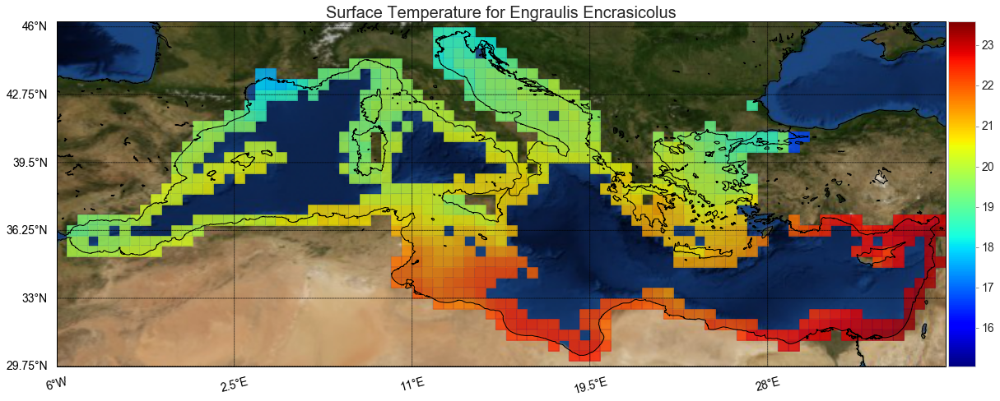

In [9]:
plot_map(data,'temperatureSurface','Surface Temperature for '+speciesName)

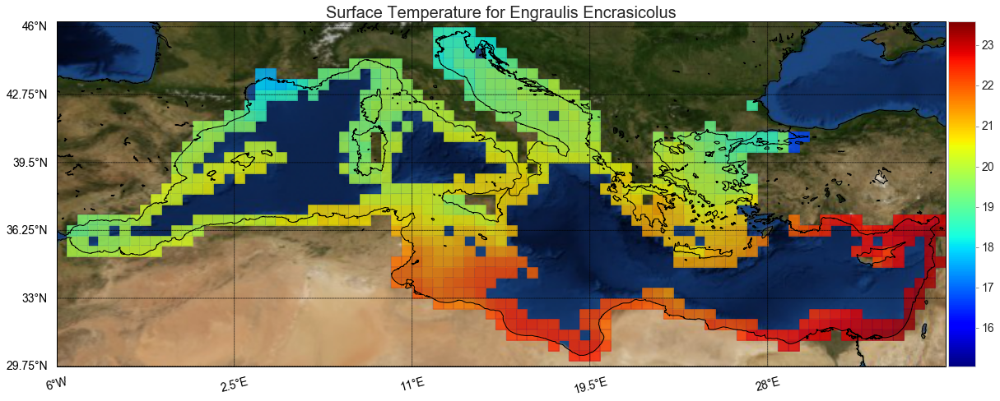

In [10]:
plot_map(data,'temperatureSurface','Surface Temperature for '+speciesName)

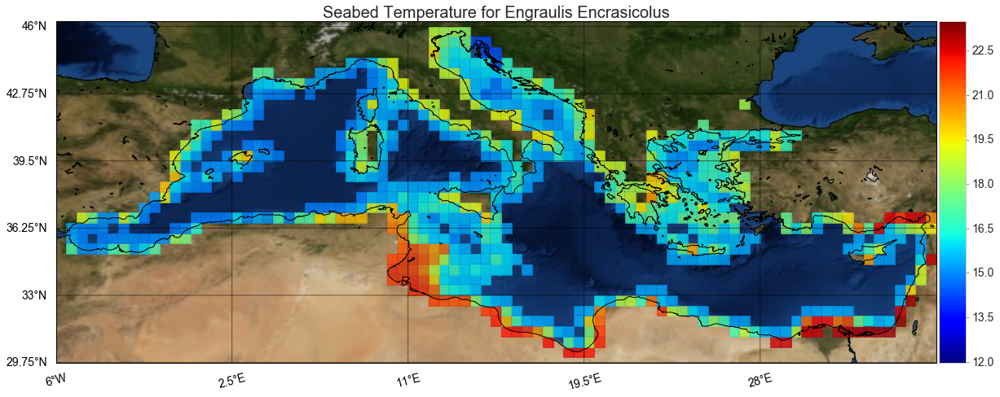

In [11]:
plot_map(data,'temperatureMaxDepth','Seabed Temperature for '+speciesName)

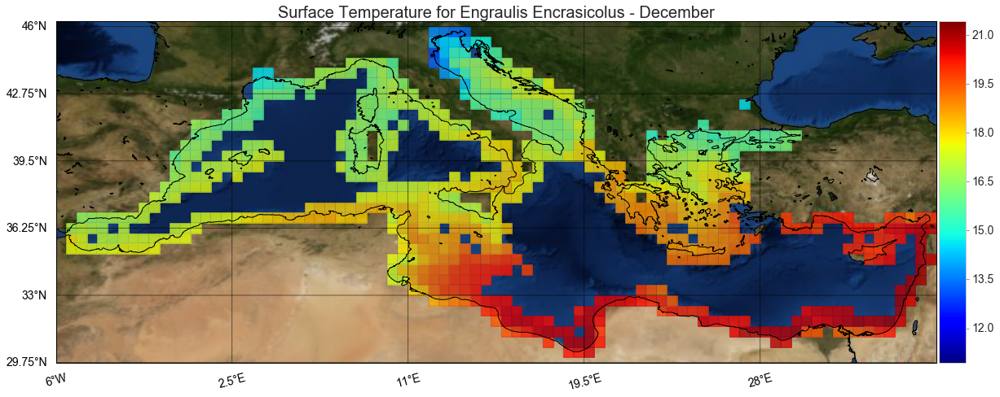

In [12]:
plot_map(data_perMonth.xs(12, level=1, drop_level=False),'temperatureSurface','Surface Temperature for '+speciesName+' - December', saveFig=True)

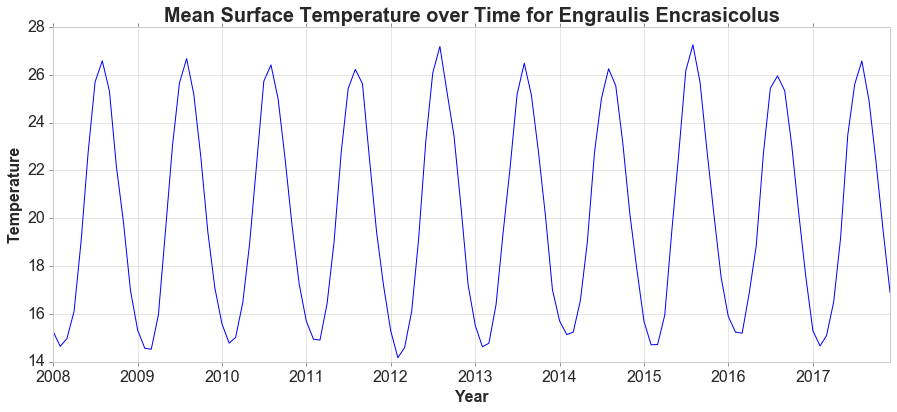

In [13]:
time_plot(data_perYearMonth,'temperatureSurface','Mean Surface Temperature over Time for '+speciesName,'Temperature')

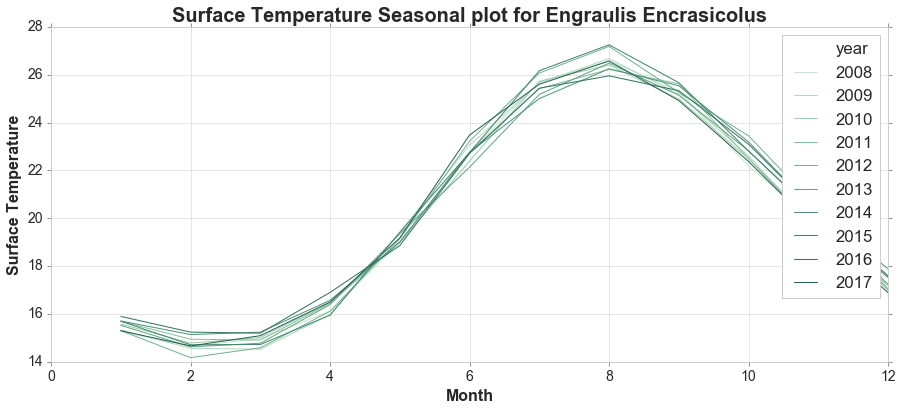

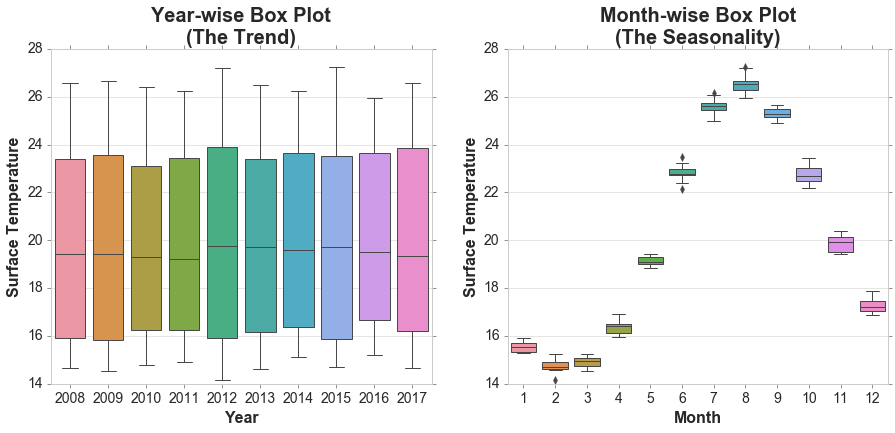

In [14]:
seasonality_plot(data_perYearMonth,'temperatureSurface','Surface Temperature Seasonal plot for '+speciesName,'Surface Temperature')

Trend strength: 0.13791248047870763
Seasonality strength: 0.9954250249361989
Augmented Dickey-Fuller Test: 
ADF test statistic       -2.249958
p-value                   0.188616
# lags used              12.000000
# observations          107.000000
critical value (1%)      -3.492996
critical value (10%)     -2.581393
critical value (5%)      -2.888955
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


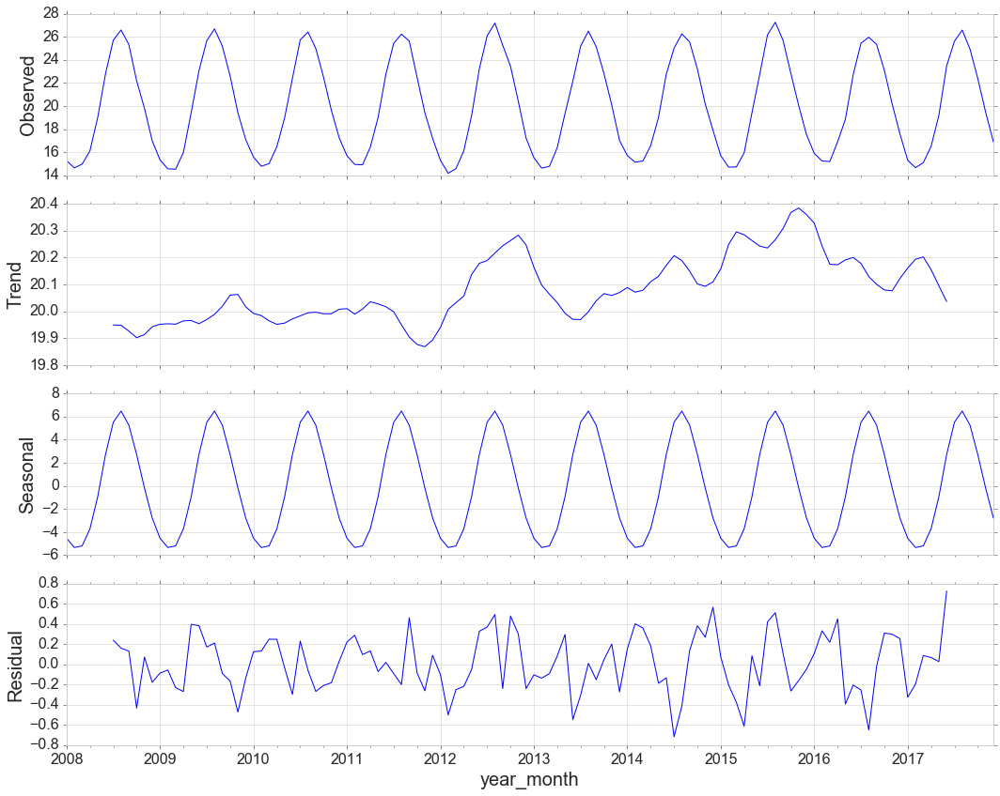

In [15]:
decomposition(data_perYearMonth,'temperatureSurface')
adf_test(data_perYearMonth['temperatureSurface'])

# Salinity

In [16]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'salinity' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
0 columns are highly positively skewed (skewness>1), while 5 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
5 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
salinityMaxDepth,float64,715,38.357541,0.548697,-1.986872,6.916886,38.539311,34.574533,38.357541,38.658152,38.870133,39.680286,0,0.0
salinity100_500,float64,713,38.357541,0.548697,-1.900481,6.415151,38.538169,34.574533,38.333084,38.651892,38.892232,39.680286,0,0.0
salinity300_400,float64,712,38.481171,0.548697,-1.816829,6.021269,38.530177,34.574533,38.291737,38.634579,38.892232,39.680286,0,0.0
salinity100_300,float64,708,38.357541,0.548697,-1.666962,5.374157,38.511159,34.574533,38.231840,38.568051,38.892808,39.680286,0,0.0
salinitySurface,float64,715,37.204424,0.548697,-1.623495,7.126620,38.149789,30.464143,37.750527,38.178464,38.837480,39.701123,0,0.0


In [17]:
plot_univariate(data['salinitySurface'], speciesName+' Salinity (Surface)')
plot_univariate(data['salinityMaxDepth'], speciesName+' Salinity (Seabed)')

In [18]:
plot_univariate(data[data['Overall Probability']>=0.8]['salinitySurface'], 'High Probability '+speciesName+' Salinity (Surface)')

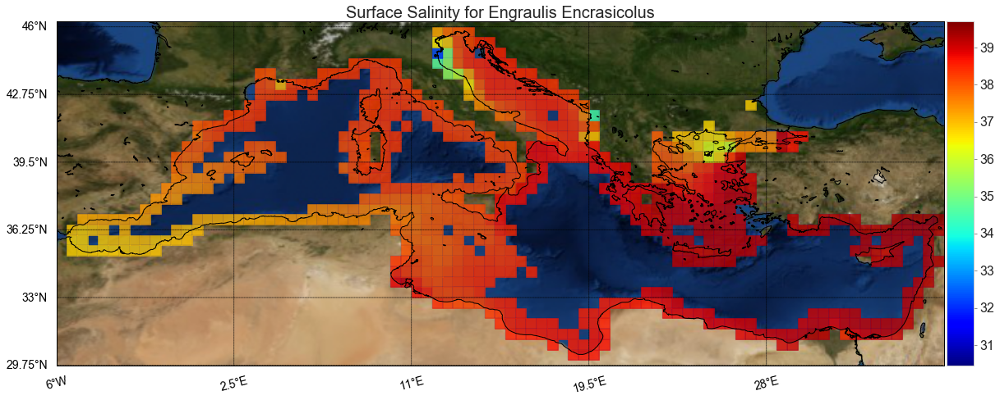

In [19]:
plot_map(data,'salinitySurface','Surface Salinity for '+speciesName)

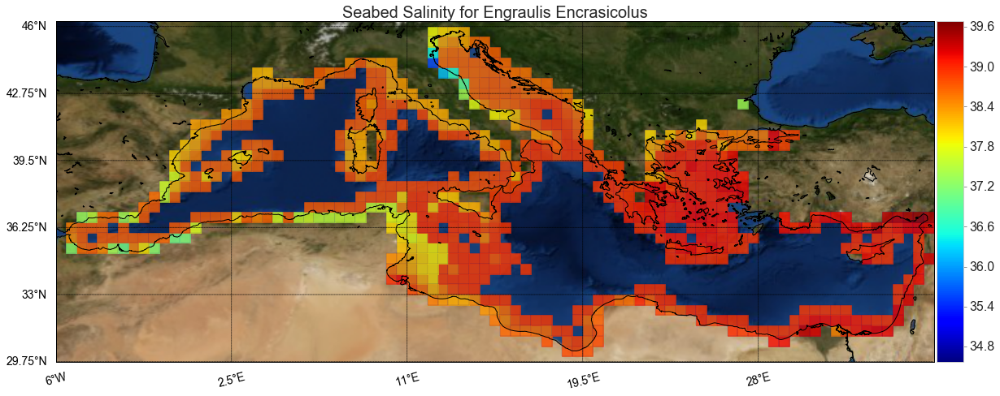

In [20]:
plot_map(data,'salinityMaxDepth','Seabed Salinity for '+speciesName)

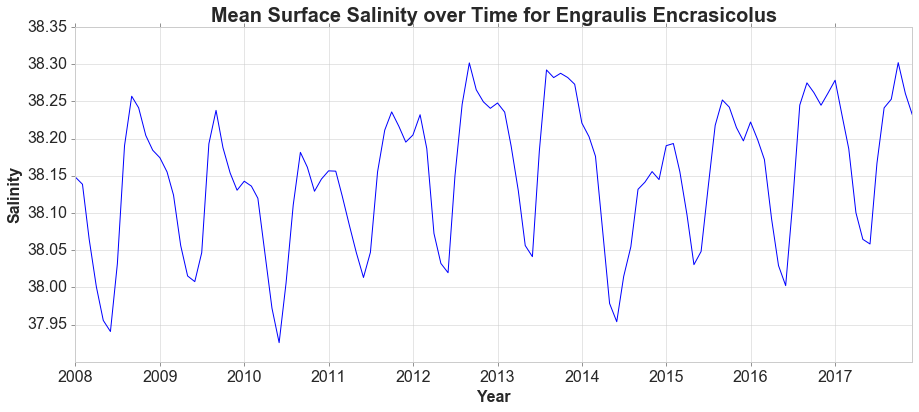

In [21]:
time_plot(data_perYearMonth,'salinitySurface','Mean Surface Salinity over Time for '+speciesName,'Salinity')

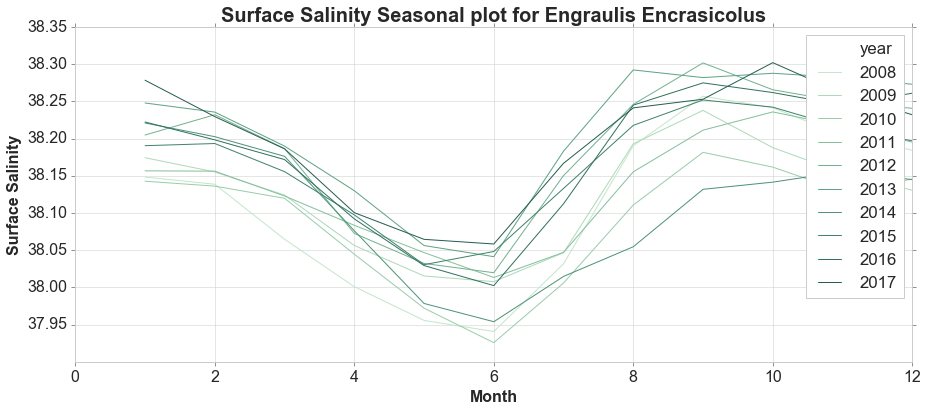

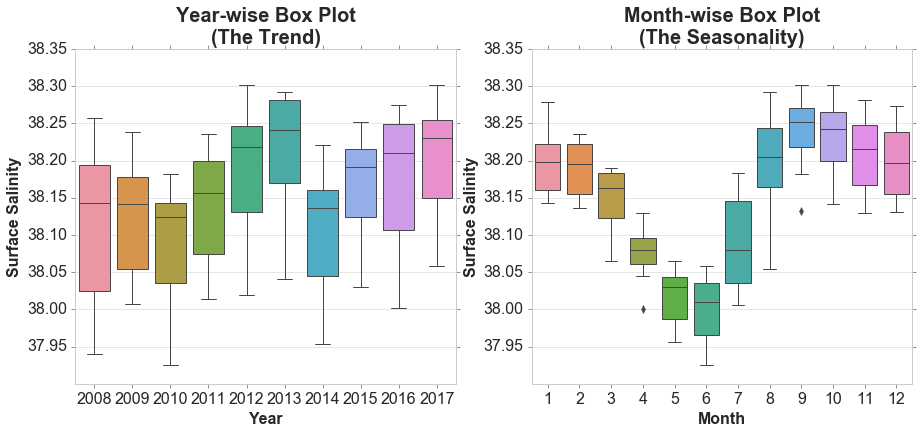

In [22]:
seasonality_plot(data_perYearMonth,'salinitySurface','Surface Salinity Seasonal plot for '+speciesName,'Surface Salinity')

Trend strength: 0.7565156490305274
Seasonality strength: 0.9225446116472529
Augmented Dickey-Fuller Test: 
ADF test statistic       -2.485053
p-value                   0.119154
# lags used              13.000000
# observations          106.000000
critical value (1%)      -3.493602
critical value (10%)     -2.581533
critical value (5%)      -2.889217
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


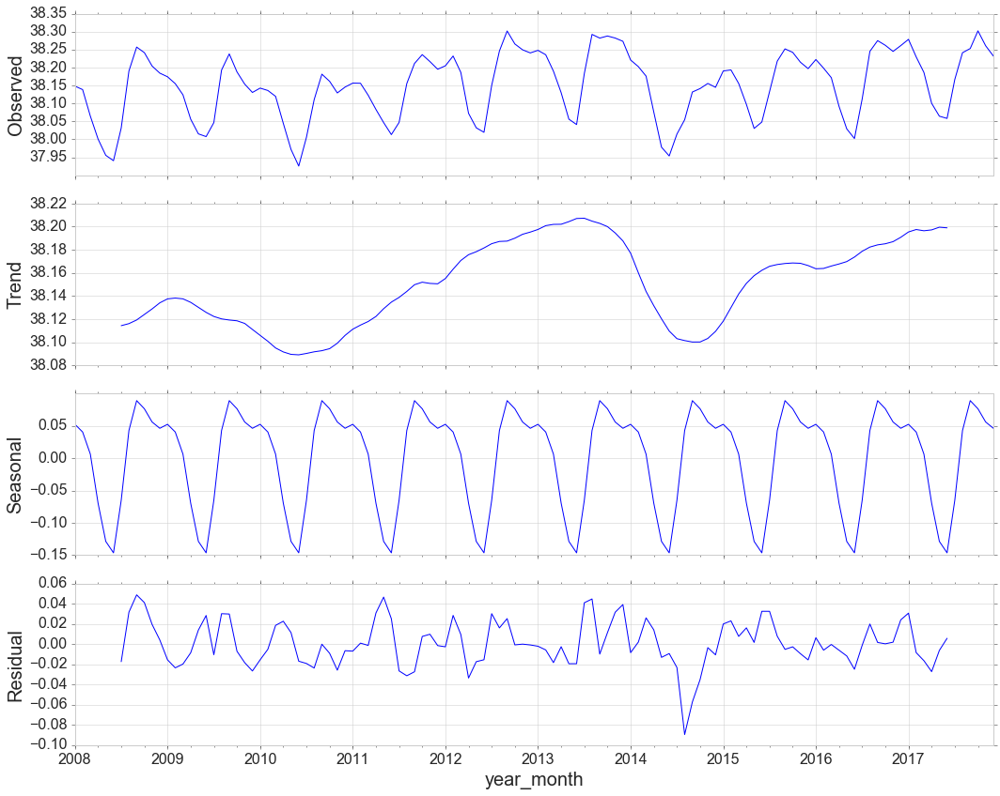

In [23]:
decomposition(data_perYearMonth,'salinitySurface')
adf_test(data_perYearMonth['salinitySurface'])

# Dissolved Oxygen

In [24]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'dissolvedOxygen' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
0 columns are highly positively skewed (skewness>1), while 5 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
5 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
dissolvedOxygenSurface,float64,726,221.322080,0.274348,-1.754017,19.041650,208.991636,111.961260,204.150728,209.803954,215.192542,292.889029,0,0.0
dissolvedOxygen100_300,float64,726,189.929629,0.274348,-1.748139,7.835142,208.382799,114.077521,200.987991,208.914836,218.549641,257.375977,0,0.0
dissolvedOxygen300_400,float64,726,189.929629,0.274348,-1.401371,6.727521,208.187368,121.556201,200.518513,207.858257,218.712710,257.375977,0,0.0
dissolvedOxygen100_500,float64,726,220.536070,0.274348,-1.329194,6.691088,207.874456,121.556201,200.246035,206.872648,218.475976,257.375977,0,0.0
dissolvedOxygenMaxDepth,float64,726,220.536070,0.274348,-1.020206,5.634961,207.256793,121.556201,198.296608,204.849794,218.393326,257.375977,0,0.0


In [25]:
plot_univariate(data['dissolvedOxygenSurface'], speciesName+' Dissolved Oxygen (Surface)')
plot_univariate(data['dissolvedOxygenMaxDepth'], speciesName+' Dissolved Oxygen (Seabed)')

In [26]:
plot_univariate(data[data['Overall Probability']>=0.8]['dissolvedOxygenSurface'], 'High Probability '+speciesName+' Dissolved Oxygen (Surface)')

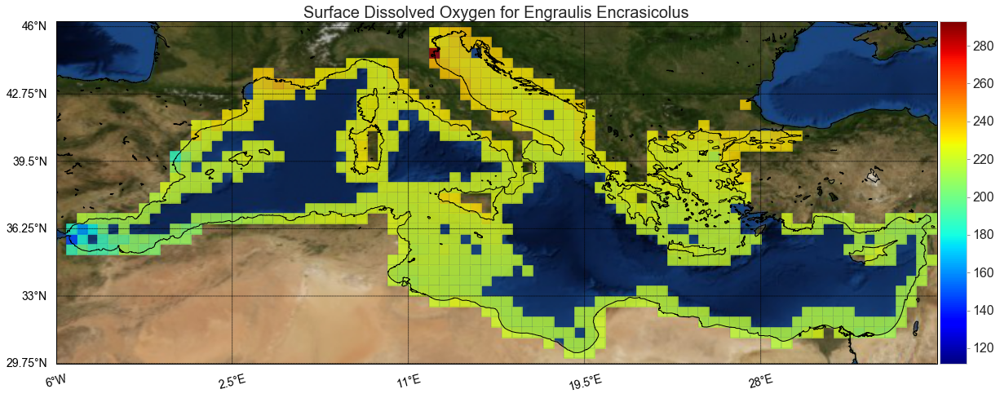

In [27]:
plot_map(data,'dissolvedOxygenSurface','Surface Dissolved Oxygen for '+speciesName)

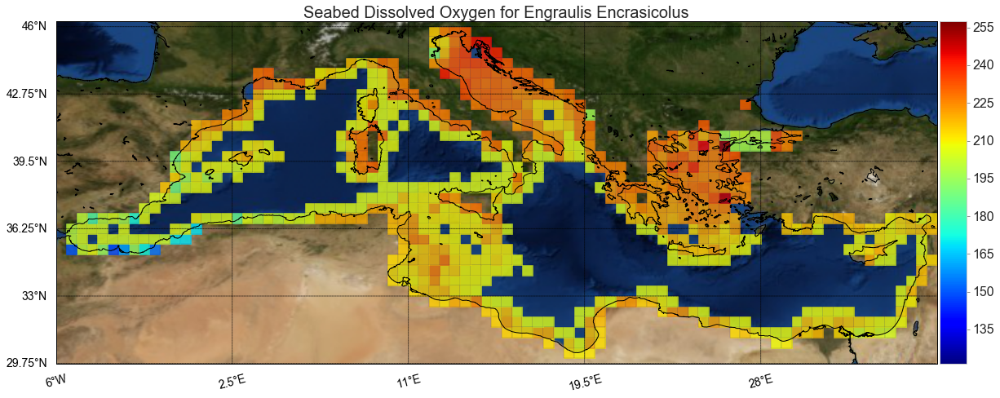

In [28]:
plot_map(data,'dissolvedOxygenMaxDepth','Seabed Dissolved Oxygen for '+speciesName)

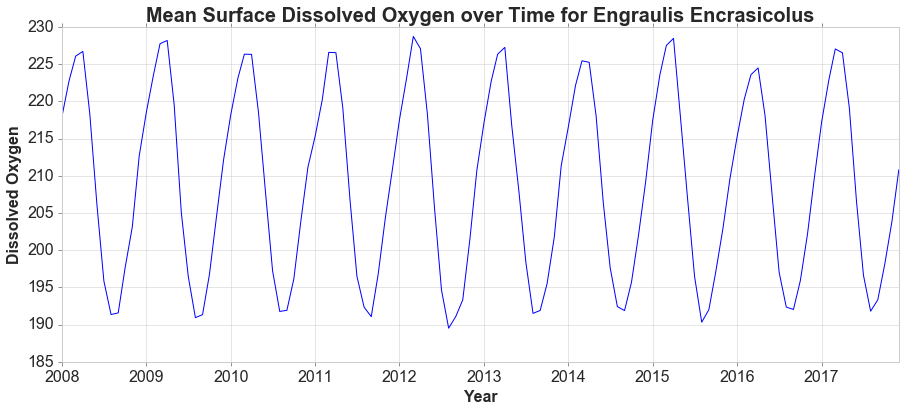

In [29]:
time_plot(data_perYearMonth,'dissolvedOxygenSurface','Mean Surface Dissolved Oxygen over Time for '+speciesName,'Dissolved Oxygen')

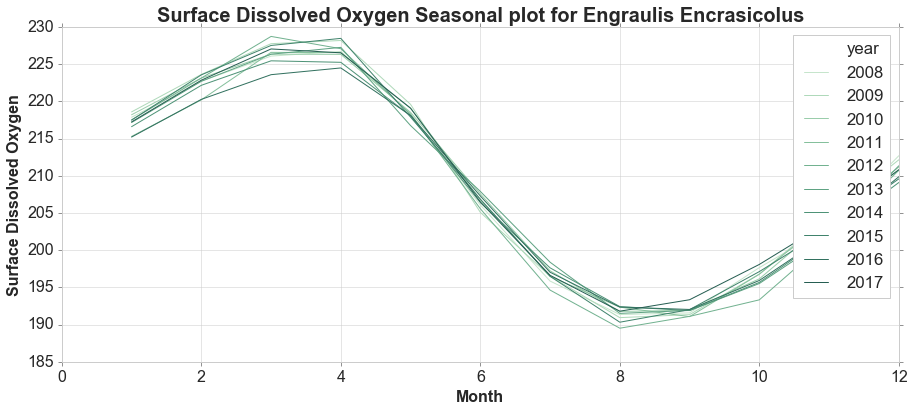

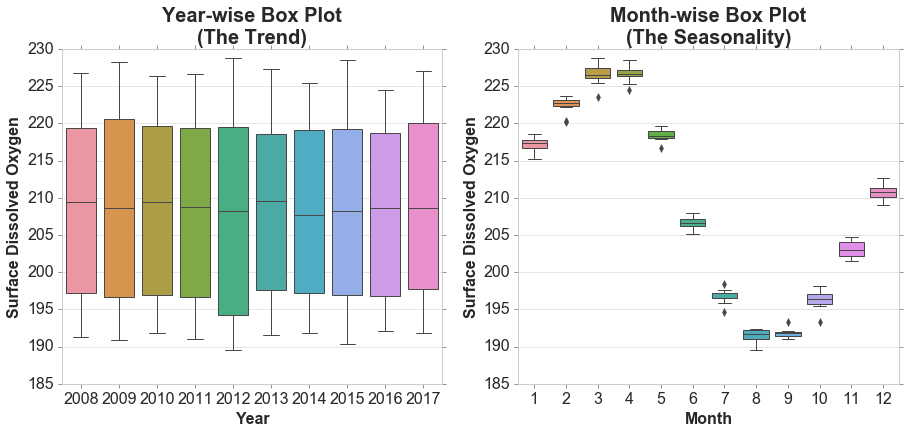

In [30]:
seasonality_plot(data_perYearMonth,'dissolvedOxygenSurface','Surface Dissolved Oxygen Seasonal plot for '+speciesName,'Surface Dissolved Oxygen')

Trend strength: 0.1814195485564276
Seasonality strength: 0.9943575018045947
Augmented Dickey-Fuller Test: 
ADF test statistic       -2.939197
p-value                   0.040976
# lags used              13.000000
# observations          106.000000
critical value (1%)      -3.493602
critical value (10%)     -2.581533
critical value (5%)      -2.889217
Strong evidence against the null hypothesis
Reject the null hypothesis
Data has no unit root and is stationary


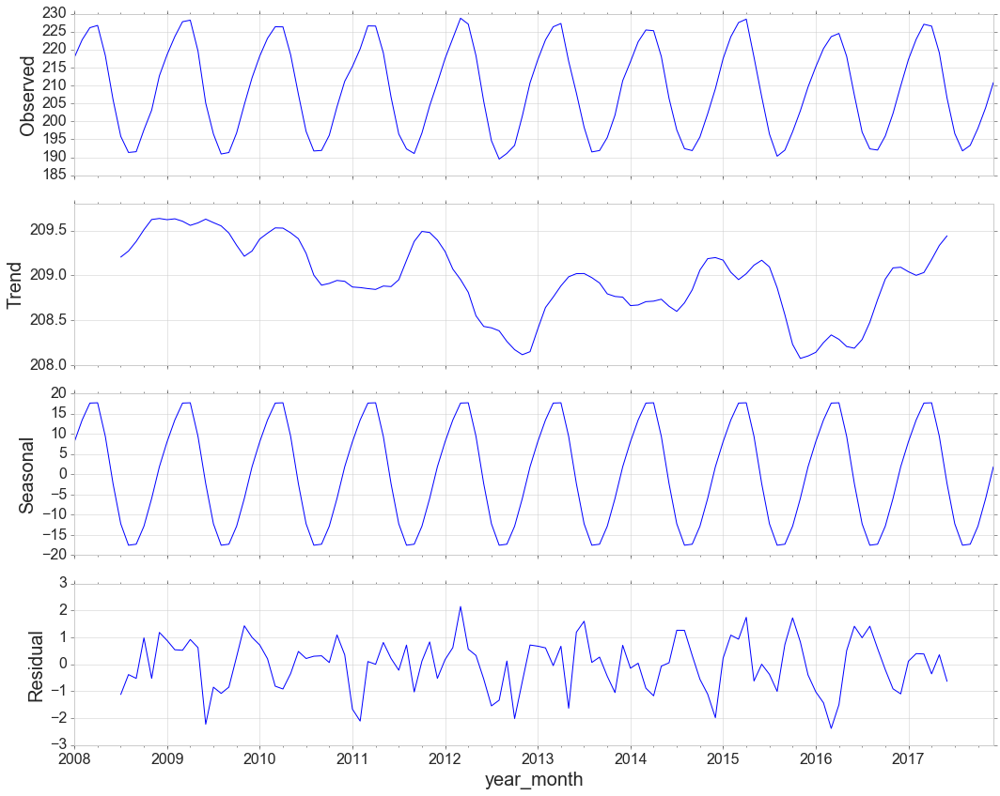

In [31]:
decomposition(data_perYearMonth,'dissolvedOxygenSurface')
adf_test(data_perYearMonth['dissolvedOxygenSurface'])

# Meridional Currect

In [32]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'meridionalCurrent' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
0 columns are highly positively skewed (skewness>1), while 3 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
5 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
meridionalCurrent100_300,float64,682,0.000000,4.663923,0.448864,22.426078,-0.000232,-0.058991,-0.002499,0.000000,0.002916,0.094715,0,0.0
meridionalCurrentMaxDepth,float64,664,0.000000,8.093278,-2.019144,15.778989,-0.000460,-0.057100,-0.001579,0.000000,0.001430,0.029719,0,0.0
meridionalCurrent300_400,float64,677,0.000000,5.898491,-2.192401,14.422386,-0.000622,-0.069289,-0.002446,0.000000,0.002290,0.031312,0,0.0
meridionalCurrent100_500,float64,676,0.000000,6.172840,-1.788695,11.587813,-0.000675,-0.058991,-0.002312,0.000000,0.001886,0.031312,0,0.0
meridionalCurrentSurface,float64,715,-0.001462,1.097394,-0.839962,8.196652,-0.008000,-0.298898,-0.018317,-0.004544,0.004129,0.191399,0,0.0


In [33]:
plot_univariate(data['meridionalCurrentSurface'], speciesName+' Meridional Current (Surface)')
plot_univariate(data['meridionalCurrentMaxDepth'], speciesName+' Meridional Current (Seabed)')

In [34]:
plot_univariate(data[data['Overall Probability']>=0.8]['meridionalCurrentSurface'], 'High Probability '+speciesName+' Meridional Current (Surface)')

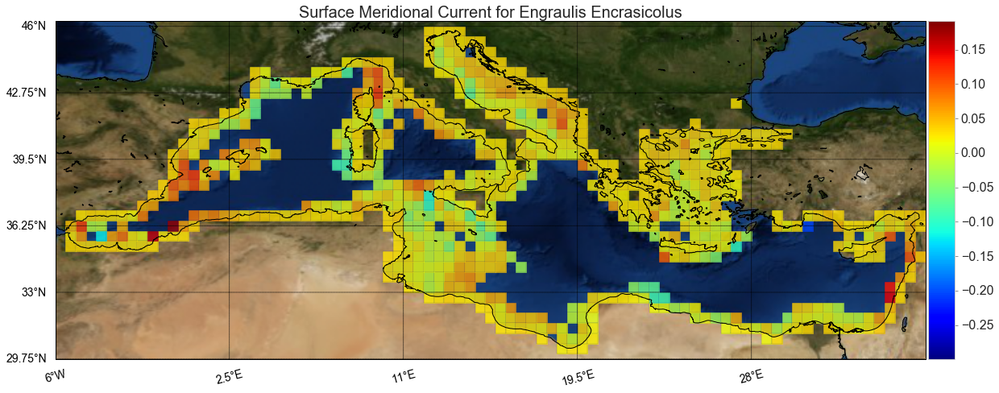

In [35]:
plot_map(data,'meridionalCurrentSurface','Surface Meridional Current for '+speciesName)

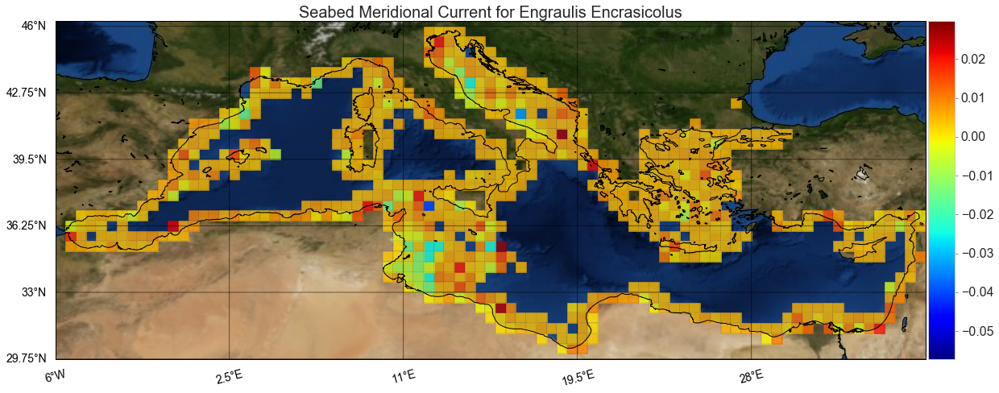

In [36]:
plot_map(data,'meridionalCurrentMaxDepth','Seabed Meridional Current for '+speciesName)

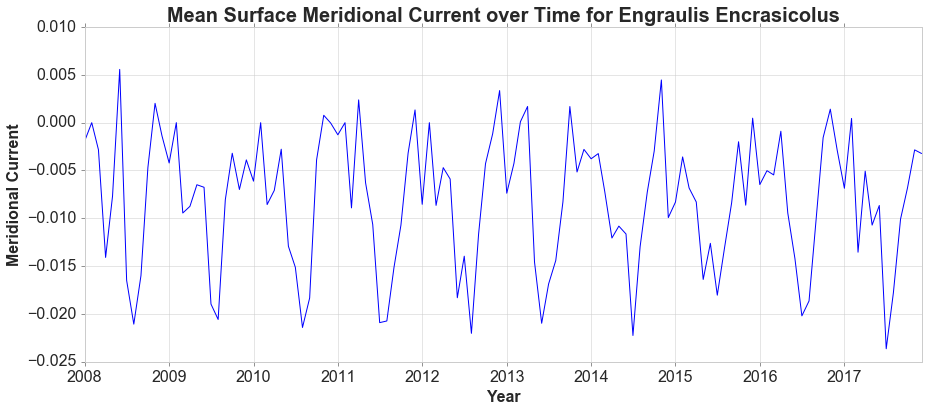

In [37]:
time_plot(data_perYearMonth,'meridionalCurrentSurface','Mean Surface Meridional Current over Time for '+speciesName,'Meridional Current')

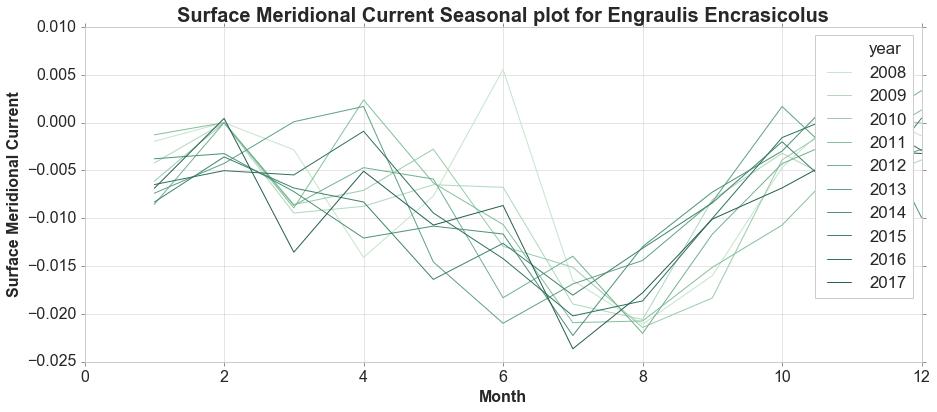

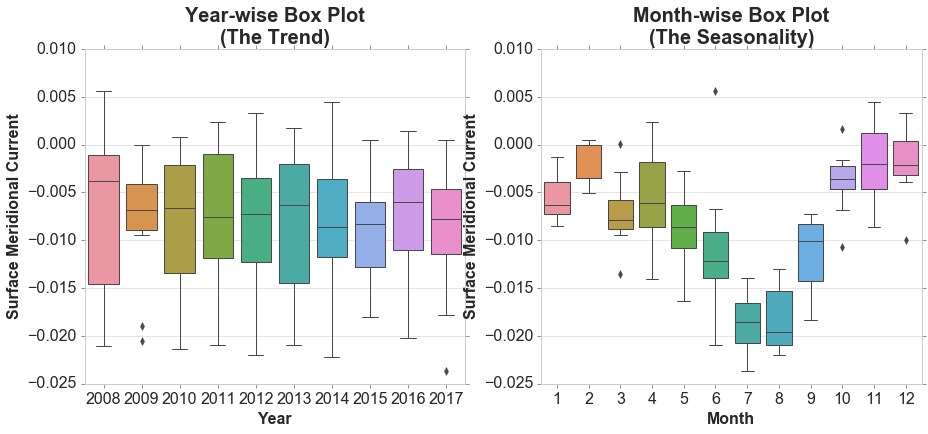

In [38]:
seasonality_plot(data_perYearMonth,'meridionalCurrentSurface','Surface Meridional Current Seasonal plot for '+speciesName,'Surface Meridional Current')

Trend strength: 0
Seasonality strength: 0.7259150492821629
Augmented Dickey-Fuller Test: 
ADF test statistic       -3.020454
p-value                   0.033028
# lags used              12.000000
# observations          107.000000
critical value (1%)      -3.492996
critical value (10%)     -2.581393
critical value (5%)      -2.888955
Strong evidence against the null hypothesis
Reject the null hypothesis
Data has no unit root and is stationary


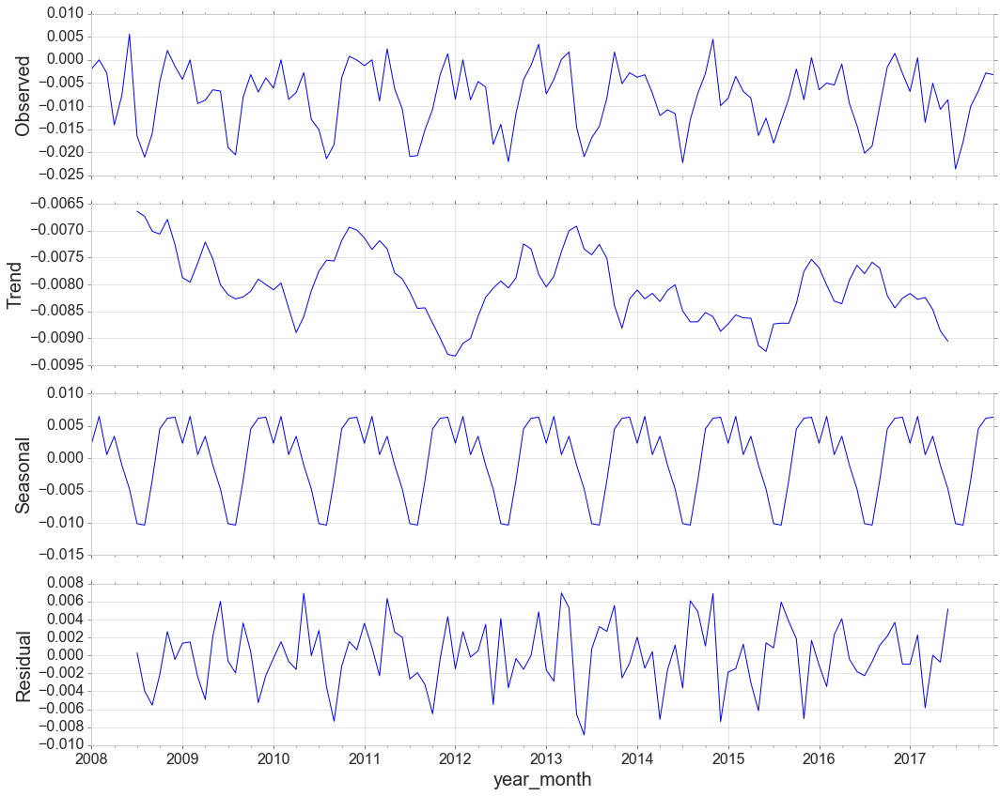

In [39]:
decomposition(data_perYearMonth,'meridionalCurrentSurface')
adf_test(data_perYearMonth['meridionalCurrentSurface'])

# Zonal Current

In [40]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'zonalCurrent' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
1 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
5 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
zonalCurrentSurface,float64,715,-0.003894,0.548697,1.426591,7.172938,0.008211,-0.234612,-0.008947,0.001097,0.016429,0.310697,0,0.0
zonalCurrentMaxDepth,float64,683,0.000000,4.663923,0.449039,17.452260,0.000629,-0.066328,-0.001450,0.000000,0.001663,0.053154,0,0.0
zonalCurrent100_500,float64,691,0.000000,3.429355,0.264242,16.217005,0.000239,-0.070082,-0.002018,-0.000104,0.002215,0.057359,0,0.0
zonalCurrent100_300,float64,689,0.000000,3.155007,0.639637,16.188636,0.000145,-0.094142,-0.002768,-0.000249,0.002554,0.083880,0,0.0
zonalCurrent300_400,float64,693,0.000000,3.017833,-0.202313,14.792633,0.000006,-0.070082,-0.002356,-0.000146,0.002431,0.057359,0,0.0


In [41]:
plot_univariate(data['zonalCurrentSurface'], speciesName+' Zonal Current (Surface)')
plot_univariate(data['zonalCurrentMaxDepth'], speciesName+' Zonal Current (Seabed)')

In [42]:
plot_univariate(data[data['Overall Probability']>=0.8]['zonalCurrentSurface'], 'High Probability '+speciesName+' Zonal Current (Surface)')

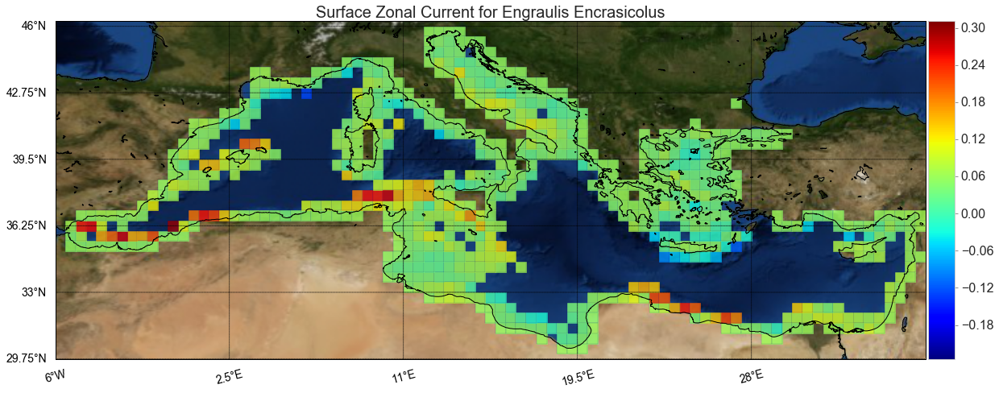

In [43]:
plot_map(data,'zonalCurrentSurface','Surface Zonal Current for '+speciesName)

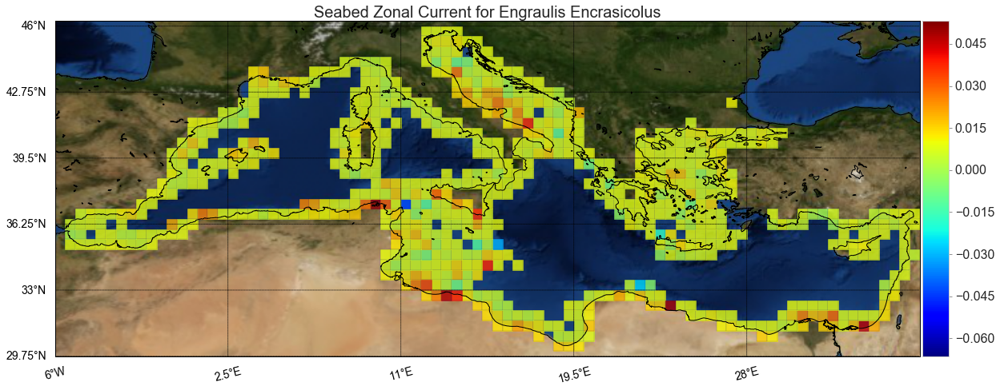

In [44]:
plot_map(data,'zonalCurrentMaxDepth','Seabed Zonal Current for '+speciesName)

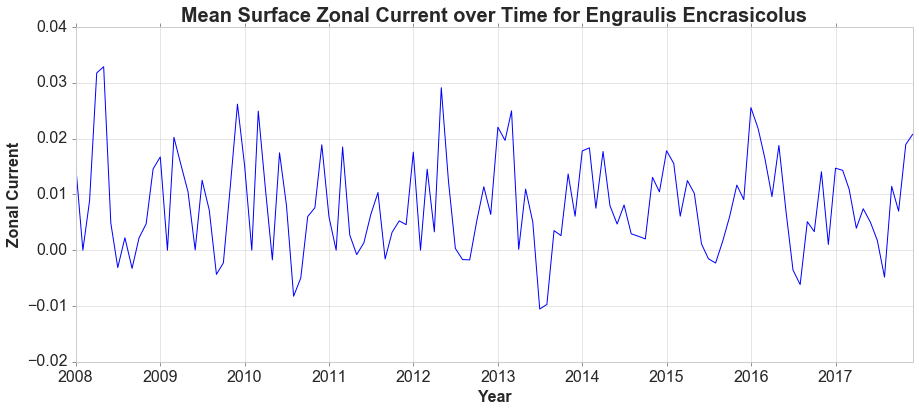

In [45]:
time_plot(data_perYearMonth,'zonalCurrentSurface','Mean Surface Zonal Current over Time for '+speciesName,'Zonal Current')

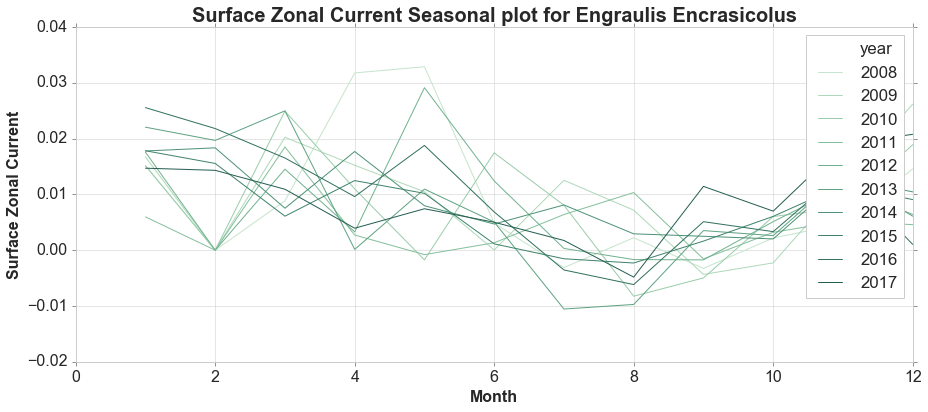

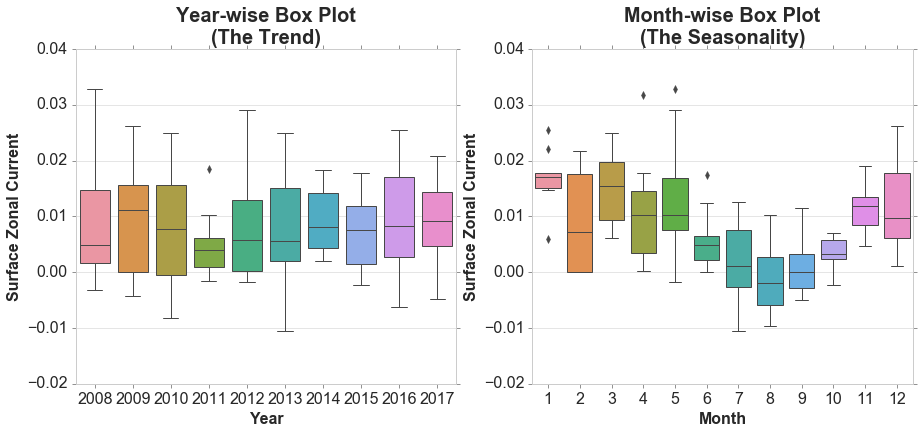

In [46]:
seasonality_plot(data_perYearMonth,'zonalCurrentSurface','Surface Zonal Current Seasonal plot for '+speciesName,'Surface Zonal Current')

Trend strength: 0.034459544209201276
Seasonality strength: 0.4682635241048305
Augmented Dickey-Fuller Test: 
ADF test statistic       -3.452207
p-value                   0.009303
# lags used              12.000000
# observations          107.000000
critical value (1%)      -3.492996
critical value (10%)     -2.581393
critical value (5%)      -2.888955
Strong evidence against the null hypothesis
Reject the null hypothesis
Data has no unit root and is stationary


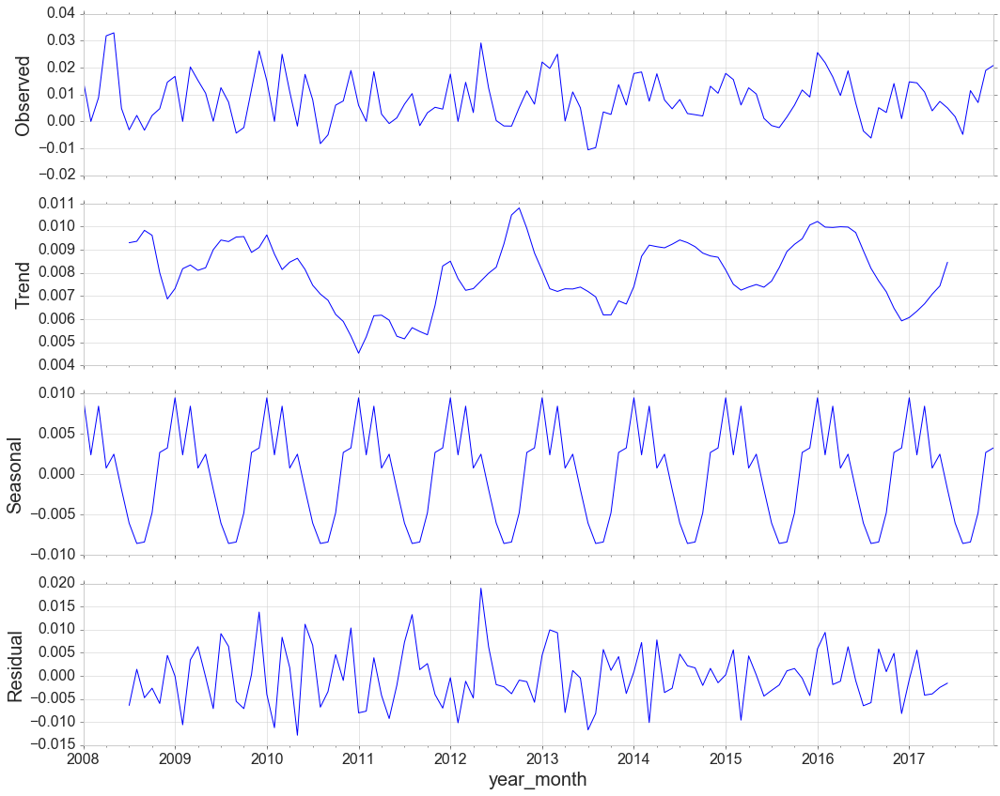

In [47]:
decomposition(data_perYearMonth,'zonalCurrentSurface')
adf_test(data_perYearMonth['zonalCurrentSurface'])

# Chlorophyll

In [48]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'chlorophyll' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
1 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
1 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
chlorophyll,float64,720,0.309317,1.371742,5.92307,41.409474,0.417729,0.041413,0.084873,0.128578,0.266674,10.363733,0,0.0


In [49]:
plot_univariate(data['chlorophyll'], speciesName+' Chlorophyll (Surface)')

In [50]:
plot_univariate(data[data['Overall Probability']>=0.8]['chlorophyll'], 'High Probability '+speciesName+' Chlorophyll (Surface)')

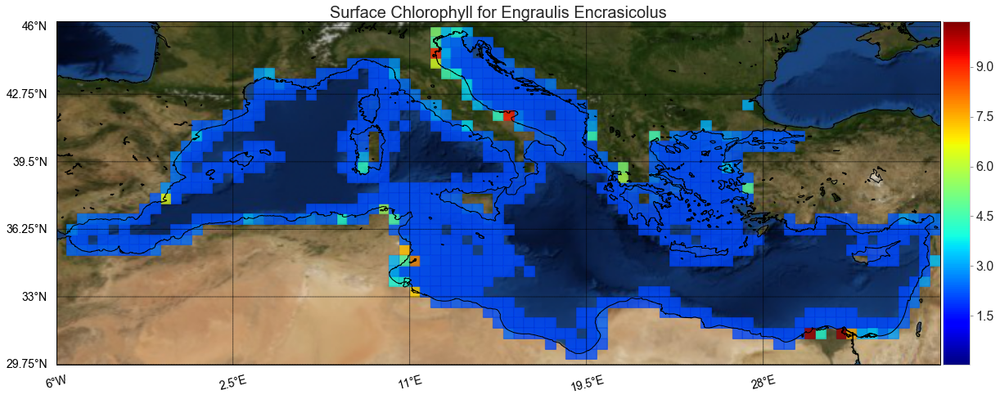

In [51]:
plot_map(data,'chlorophyll','Surface Chlorophyll for '+speciesName)

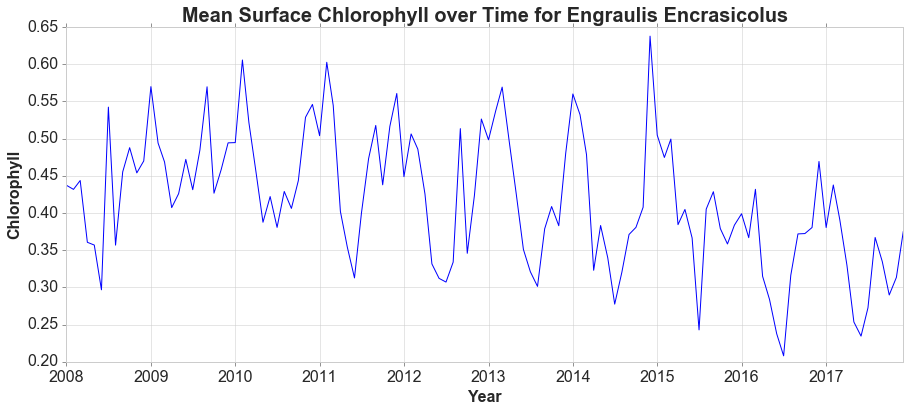

In [52]:
time_plot(data_perYearMonth,'chlorophyll','Mean Surface Chlorophyll over Time for '+speciesName,'Chlorophyll')

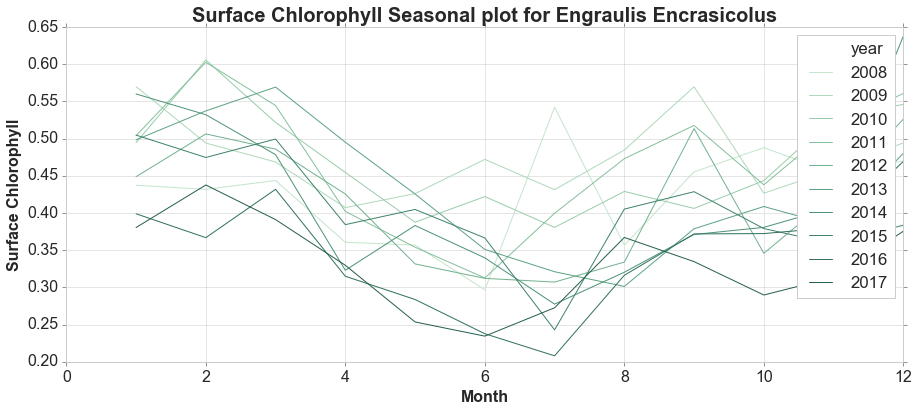

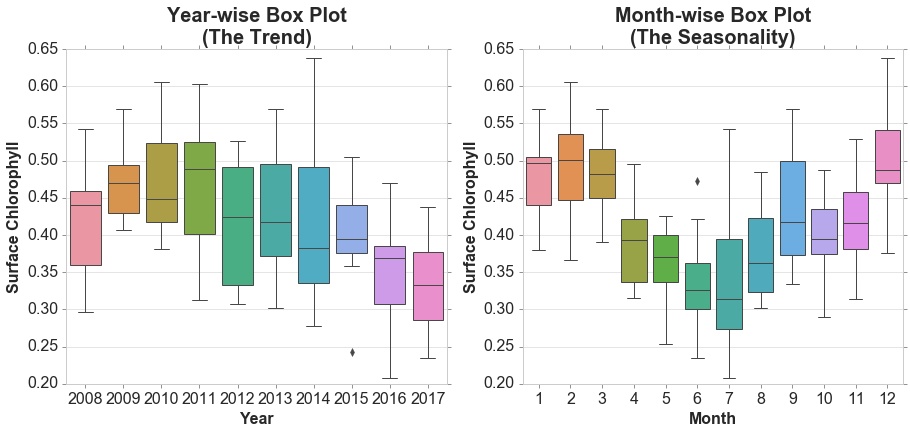

In [53]:
seasonality_plot(data_perYearMonth,'chlorophyll','Surface Chlorophyll Seasonal plot for '+speciesName,'Surface Chlorophyll')

Trend strength: 0.4676338807230973
Seasonality strength: 0.6026337633050134
Augmented Dickey-Fuller Test: 
ADF test statistic        0.013494
p-value                   0.959634
# lags used              11.000000
# observations          108.000000
critical value (1%)      -3.492401
critical value (10%)     -2.581255
critical value (5%)      -2.888697
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


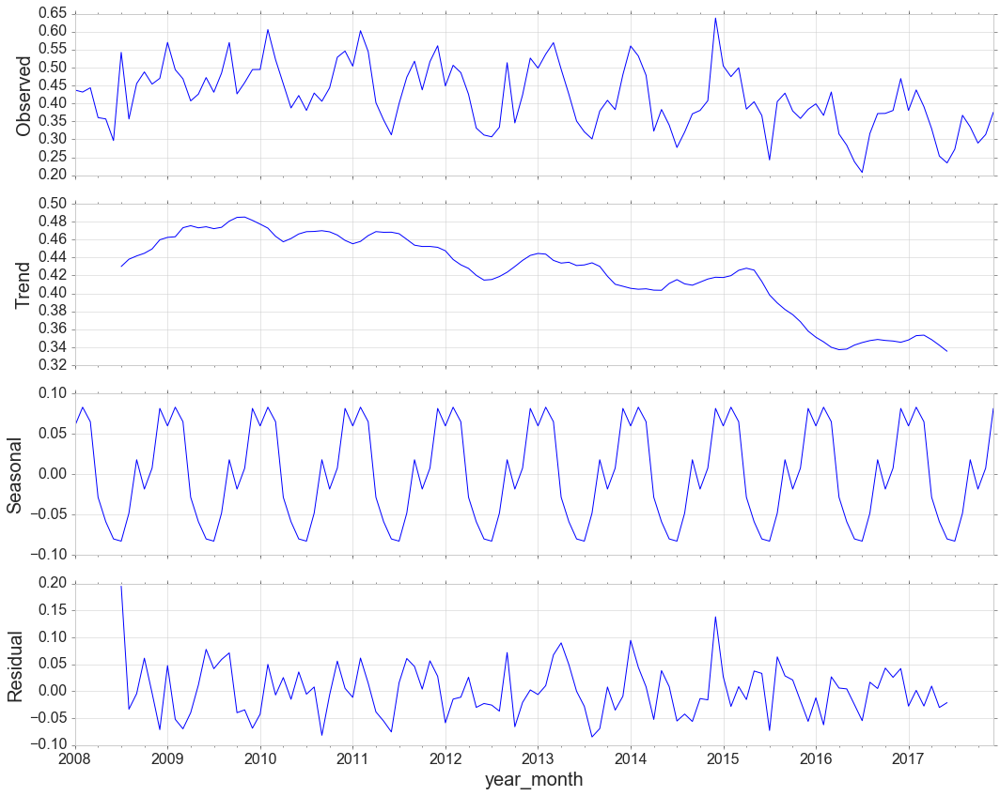

In [54]:
decomposition(data_perYearMonth,'chlorophyll')
adf_test(data_perYearMonth['chlorophyll'])

# Euphotic Depth

In [55]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'euphoticDepth' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
1 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
1 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
euphoticDepth,float64,729,-0.094923,0.137174,1.732327,3.258777,-0.521475,-1.052092,-0.772313,-0.630058,-0.413242,1.267258,0,0.0


In [56]:
plot_univariate(data['euphoticDepth'], speciesName+' Euphotic Depth')

In [57]:
plot_univariate(data[data['Overall Probability']>=0.8]['euphoticDepth'], 'High Probability '+speciesName+' Euphotic Depth')

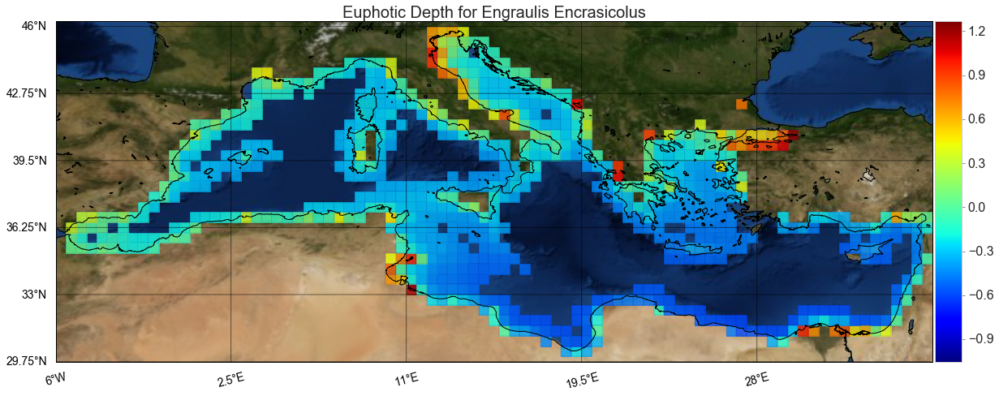

In [58]:
plot_map(data,'euphoticDepth','Euphotic Depth for '+speciesName)

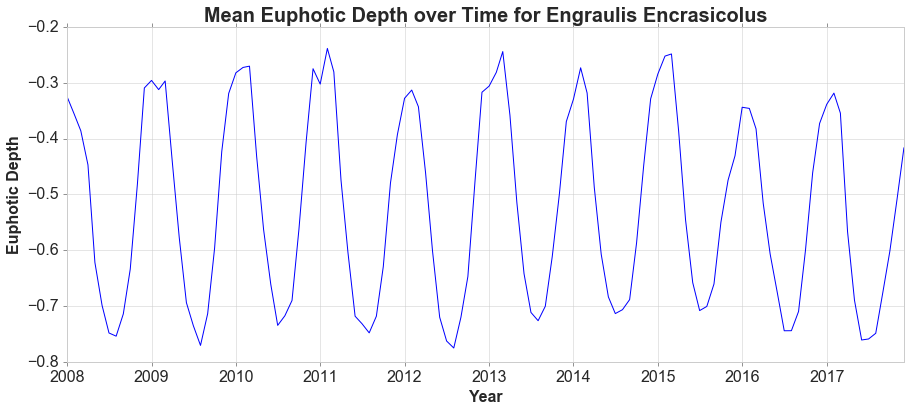

In [59]:
time_plot(data_perYearMonth,'euphoticDepth','Mean Euphotic Depth over Time for '+speciesName,'Euphotic Depth')

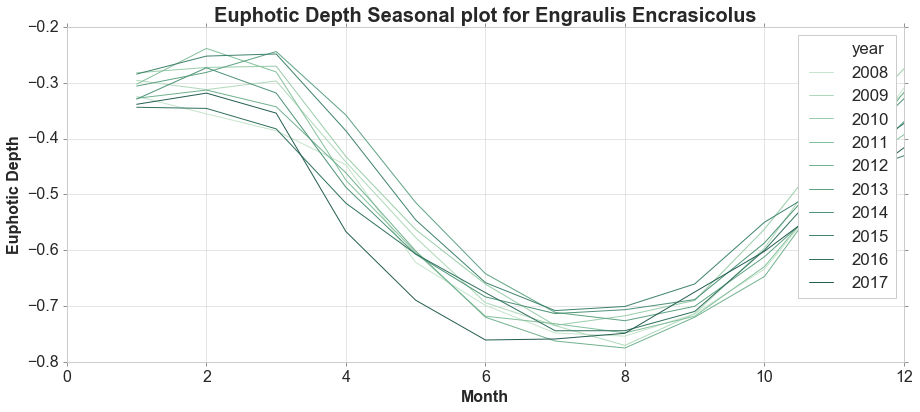

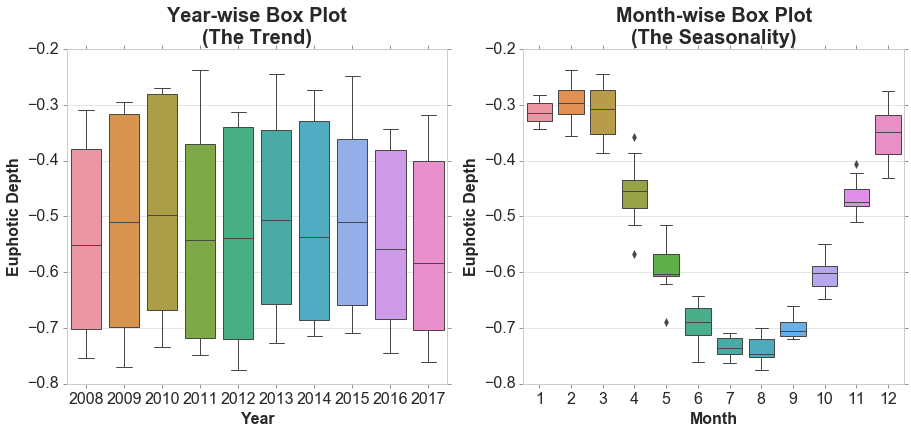

In [60]:
seasonality_plot(data_perYearMonth,'euphoticDepth','Euphotic Depth Seasonal plot for '+speciesName,'Euphotic Depth')

Trend strength: 0.5362359511094004
Seasonality strength: 0.9794677089825085
Augmented Dickey-Fuller Test: 
ADF test statistic       -1.695389
p-value                   0.433490
# lags used              12.000000
# observations          107.000000
critical value (1%)      -3.492996
critical value (10%)     -2.581393
critical value (5%)      -2.888955
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


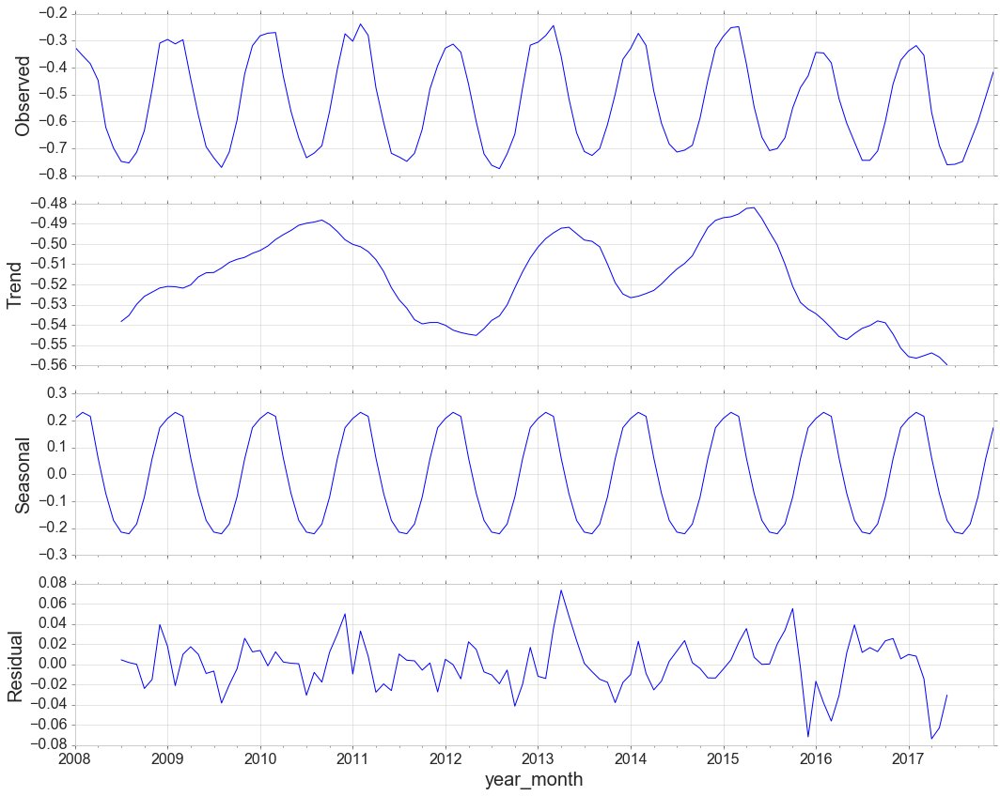

In [61]:
decomposition(data_perYearMonth,'euphoticDepth')
adf_test(data_perYearMonth['euphoticDepth'])

# Secchi Disk Depth

In [62]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'secchiDiskDepth' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
0 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
0 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 1 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
secchiDiskDepth,float64,729,30.112111,0.137174,-0.559556,-0.605756,19.125627,1.785862,13.92553,20.913528,24.50713,32.253208,0,0.0


In [63]:
plot_univariate(data['secchiDiskDepth'], speciesName+' Secchi Disk Depth')

In [64]:
plot_univariate(data[data['Overall Probability']>=0.8]['secchiDiskDepth'], 'High Probability '+speciesName+' Secchi Disk Depth')

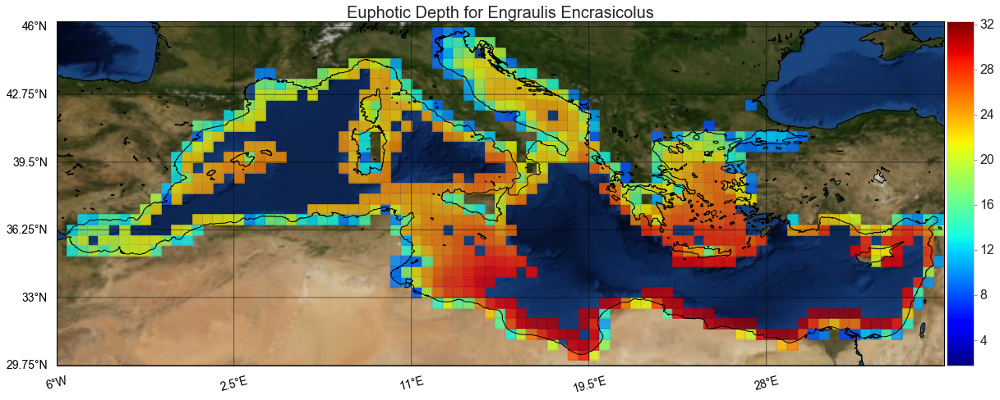

In [65]:
plot_map(data,'secchiDiskDepth','Euphotic Depth for '+speciesName)

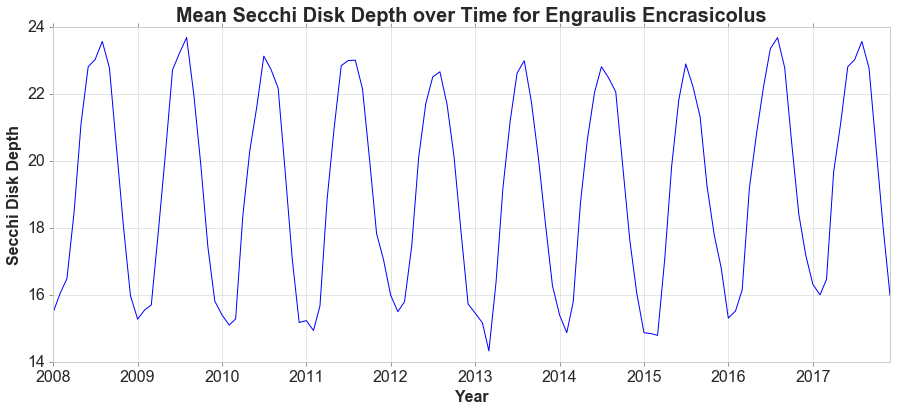

In [66]:
time_plot(data_perYearMonth,'secchiDiskDepth','Mean Secchi Disk Depth over Time for '+speciesName,'Secchi Disk Depth')

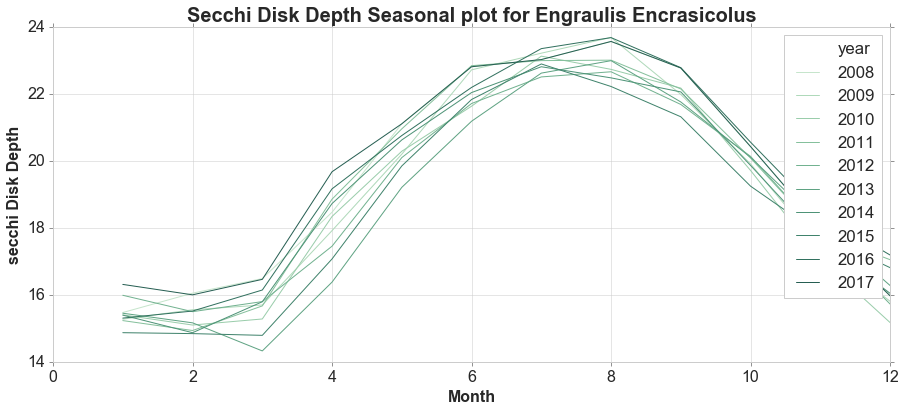

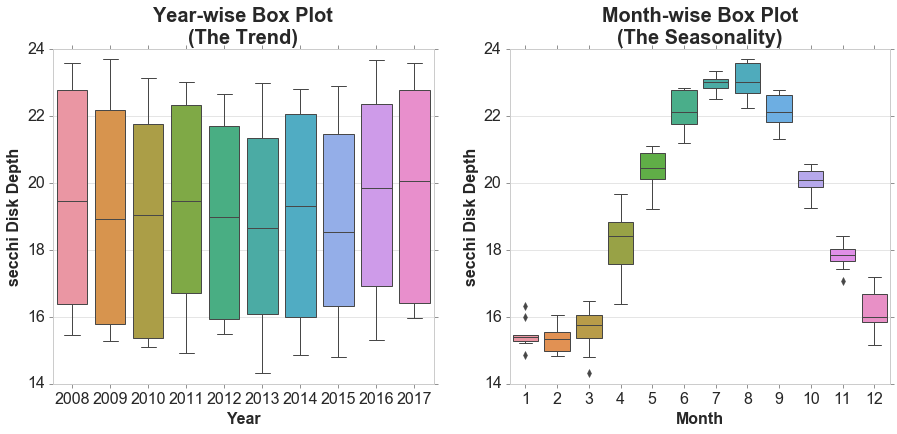

In [67]:
seasonality_plot(data_perYearMonth,'secchiDiskDepth','Secchi Disk Depth Seasonal plot for '+speciesName,'secchi Disk Depth')

Trend strength: 0.5185059479237288
Seasonality strength: 0.9836872658816516
Augmented Dickey-Fuller Test: 
ADF test statistic       -1.912428
p-value                   0.326237
# lags used              12.000000
# observations          107.000000
critical value (1%)      -3.492996
critical value (10%)     -2.581393
critical value (5%)      -2.888955
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


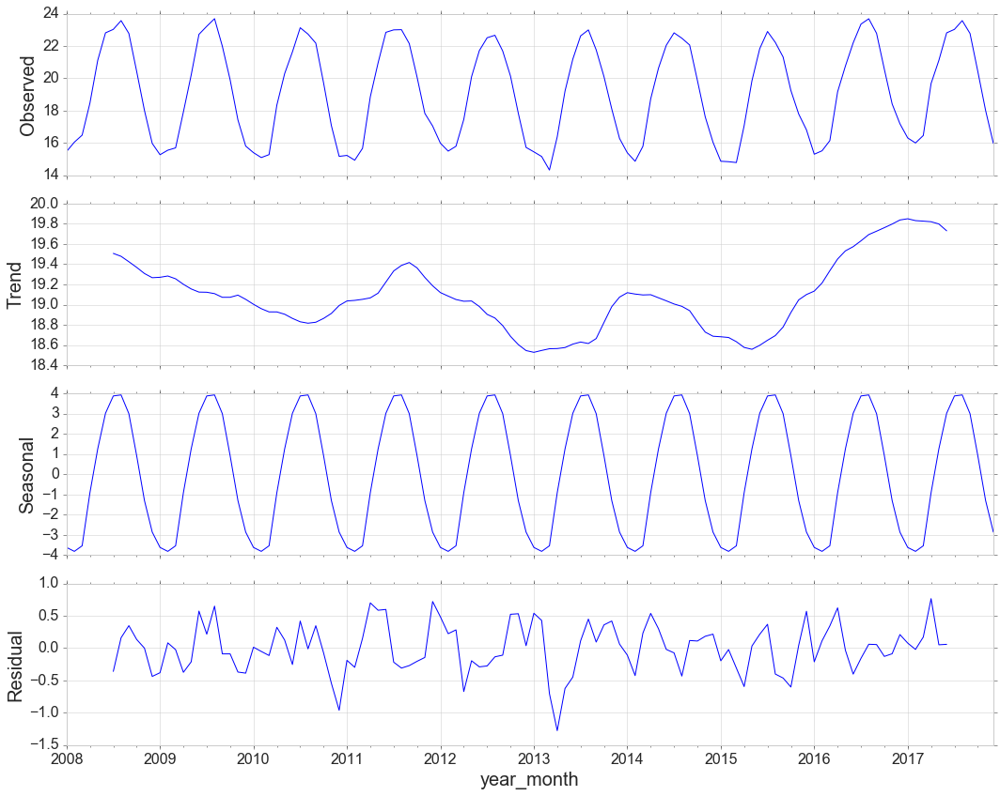

In [68]:
decomposition(data_perYearMonth,'secchiDiskDepth')
adf_test(data_perYearMonth['secchiDiskDepth'])

# Wave Height

In [69]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'wave_Height' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
0 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
1 columns are symmetrical (-0.5<skewness<0.5).
0 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 1 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
wave_Height,float64,719,0.836839,0.960219,-0.269881,-0.748008,0.784538,0.1102,0.561283,0.808941,1.029687,1.410494,0,0.0


In [70]:
plot_univariate(data['wave_Height'], speciesName+' Wave Height')

In [71]:
plot_univariate(data[data['Overall Probability']>=0.8]['wave_Height'], 'High Probability '+speciesName+' Wave Height')

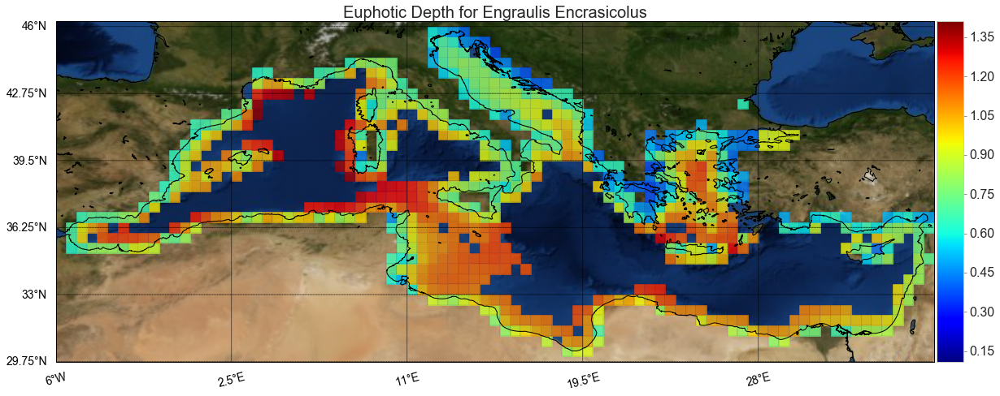

In [72]:
plot_map(data,'wave_Height','Euphotic Depth for '+speciesName)

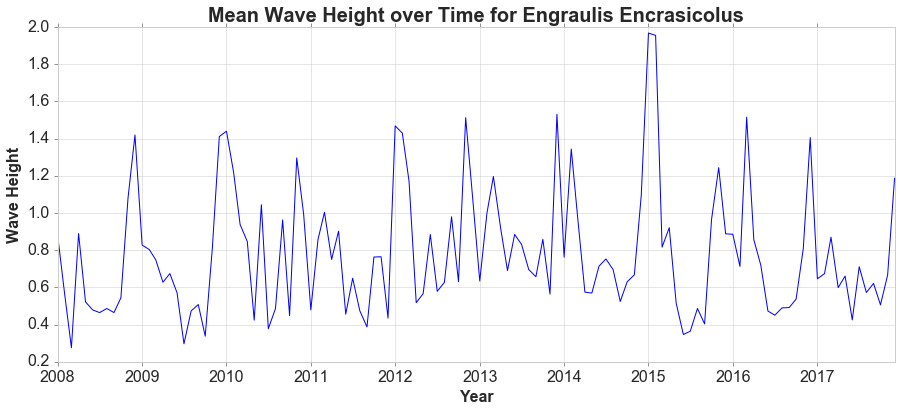

In [73]:
time_plot(data_perYearMonth,'wave_Height','Mean Wave Height over Time for '+speciesName,'Wave Height')

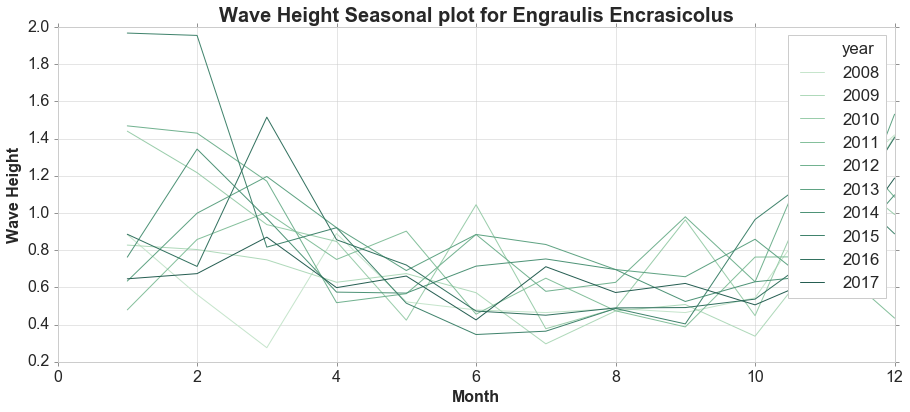

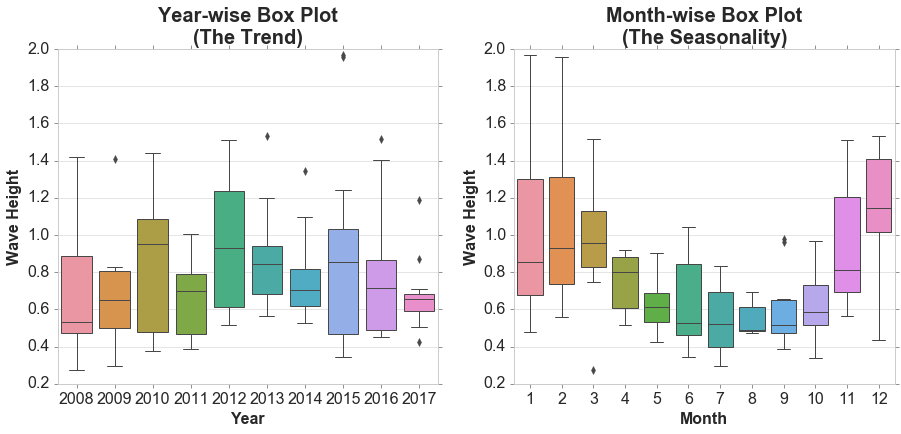

In [74]:
seasonality_plot(data_perYearMonth,'wave_Height','Wave Height Seasonal plot for '+speciesName,'Wave Height')

Trend strength: 0.057341081640096325
Seasonality strength: 0.42866050604744266
Augmented Dickey-Fuller Test: 
ADF test statistic     -6.434595e+00
p-value                 1.664895e-08
# lags used             6.000000e+00
# observations          1.130000e+02
critical value (1%)    -3.489590e+00
critical value (10%)   -2.580604e+00
critical value (5%)    -2.887477e+00
Strong evidence against the null hypothesis
Reject the null hypothesis
Data has no unit root and is stationary


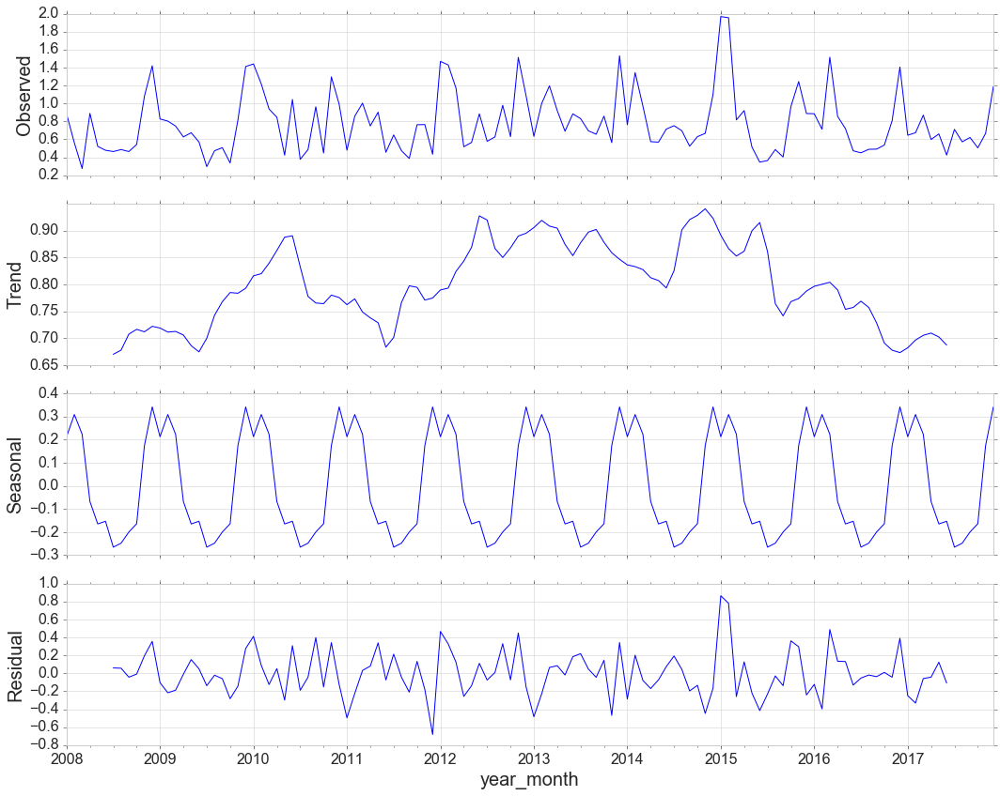

In [75]:
decomposition(data_perYearMonth,'wave_Height')
adf_test(data_perYearMonth['wave_Height'])

# Nitrate

In [76]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'nitrate' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
4 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
1 columns are symmetrical (-0.5<skewness<0.5).
2 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 3 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
nitrateMaxDepth,float64,726,2.609148,0.274348,0.793992,0.160092,2.321608,0.003647,0.311358,1.878358,3.563347,12.566309,0,0.0
nitrate100_500,float64,726,2.609148,0.274348,1.007042,1.280954,2.046116,0.003647,0.287902,1.586513,3.139221,12.566309,0,0.0
nitrate300_400,float64,726,2.609148,0.274348,1.144559,1.877140,1.936888,0.003647,0.283600,1.381258,3.095263,12.566309,0,0.0
nitrate100_300,float64,726,0.199781,0.274348,1.392091,3.069489,1.753677,0.003647,0.262865,1.206476,2.901550,12.566309,0,0.0
nitrateSurface,float64,726,0.292165,0.274348,21.010507,507.792333,0.611703,0.006719,0.062936,0.142110,0.267393,89.569026,0,0.0


In [77]:
plot_univariate(data['nitrateSurface'], speciesName+' Nitrate (Surface)')
plot_univariate(data['nitrateMaxDepth'], speciesName+' Nitrate (Seabed)')

In [78]:
plot_univariate(data[data['Overall Probability']>=0.8]['nitrateSurface'], 'High Probability '+speciesName+' Nitrate (Surface)')

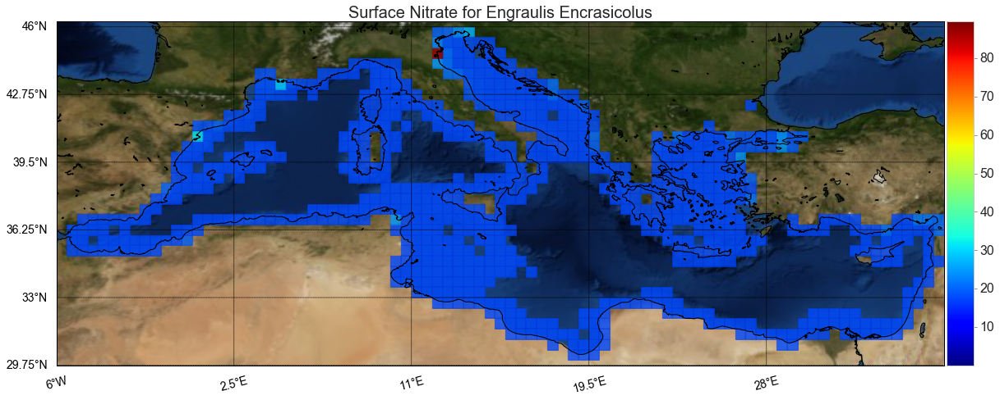

In [79]:
plot_map(data,'nitrateSurface','Surface Nitrate for '+speciesName)

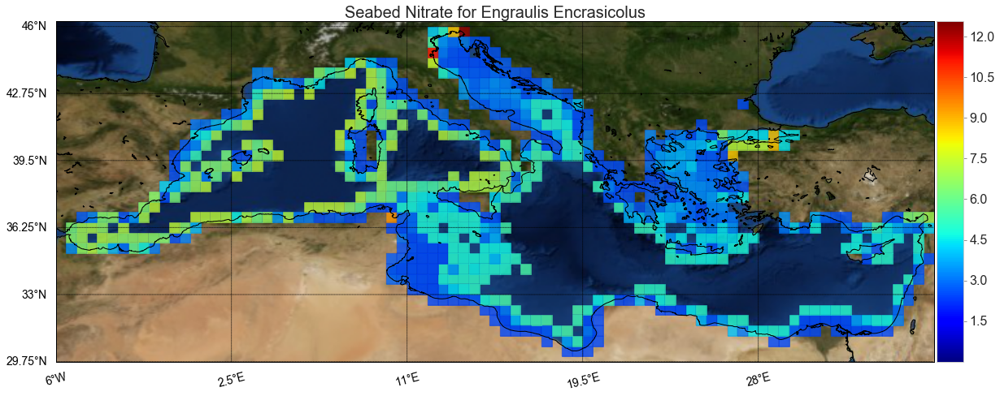

In [80]:
plot_map(data,'nitrateMaxDepth','Seabed Nitrate for '+speciesName)

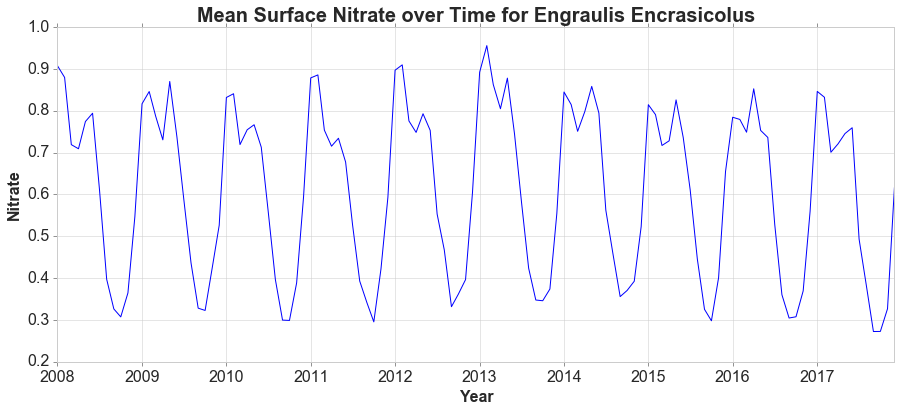

In [81]:
time_plot(data_perYearMonth,'nitrateSurface','Mean Surface Nitrate over Time for '+speciesName,'Nitrate')

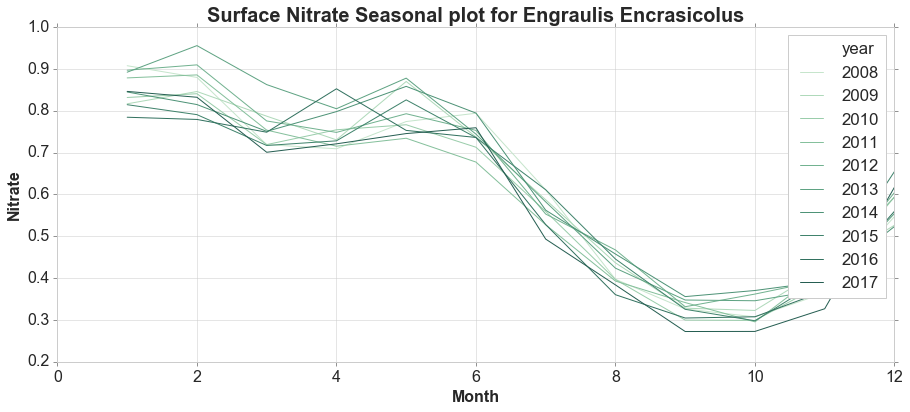

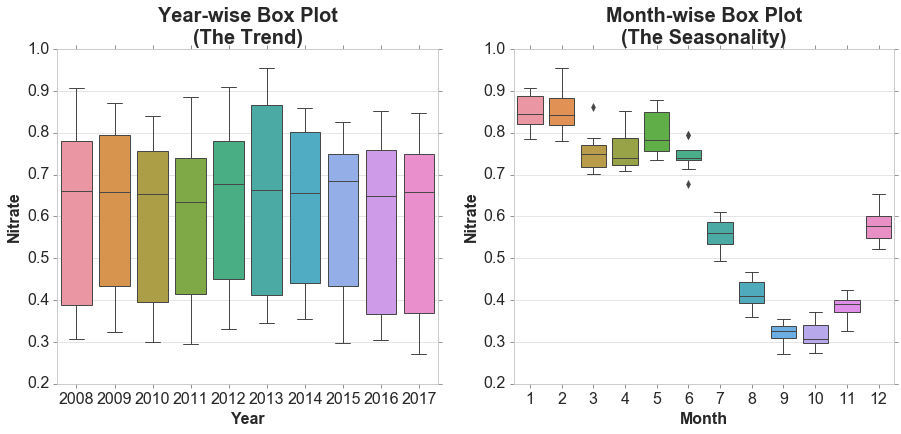

In [82]:
seasonality_plot(data_perYearMonth,'nitrateSurface','Surface Nitrate Seasonal plot for '+speciesName,'Nitrate')

Trend strength: 0.2750785741248455
Seasonality strength: 0.9740356179487045
Augmented Dickey-Fuller Test: 
ADF test statistic       -0.815941
p-value                   0.814395
# lags used              11.000000
# observations          108.000000
critical value (1%)      -3.492401
critical value (10%)     -2.581255
critical value (5%)      -2.888697
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


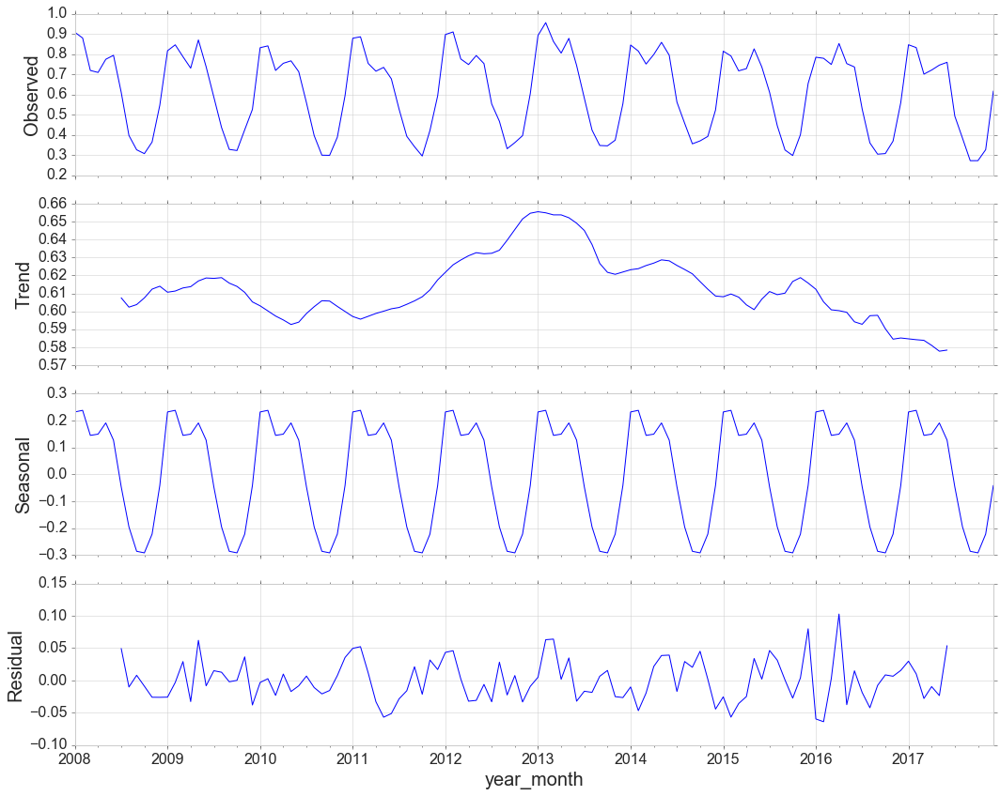

In [83]:
decomposition(data_perYearMonth,'nitrateSurface')
adf_test(data_perYearMonth['nitrateSurface'])

# Phosphate

In [84]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'phosphate' in c])

Your selected dataframe has 5 columns. (0 categorical and 5 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
4 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
2 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 3 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
phosphateMaxDepth,float64,726,0.011072,0.274348,0.964647,1.735771,0.118943,0.004161,0.029406,0.117032,0.158007,0.564494,0,0.0
phosphate100_500,float64,726,0.011072,0.274348,1.129254,2.504370,0.112596,0.004161,0.029027,0.103994,0.150060,0.564494,0,0.0
phosphate300_400,float64,726,0.014019,0.274348,1.203105,2.748397,0.109964,0.004161,0.028746,0.099430,0.147455,0.564494,0,0.0
phosphate100_300,float64,726,0.011072,0.274348,1.328528,3.151294,0.104921,0.004161,0.027168,0.086822,0.145829,0.564494,0,0.0
phosphateSurface,float64,726,0.009467,0.274348,16.258469,349.889503,0.020375,0.004200,0.010663,0.015704,0.021219,0.720065,0,0.0


In [85]:
plot_univariate(data['phosphateSurface'], speciesName+' Phosphate (Surface)')
plot_univariate(data['phosphateMaxDepth'], speciesName+' Phosphate (Seabed)')

In [86]:
plot_univariate(data[data['Overall Probability']>=0.8]['phosphateSurface'], 'High Probability '+speciesName+' Phosphate (Surface)')

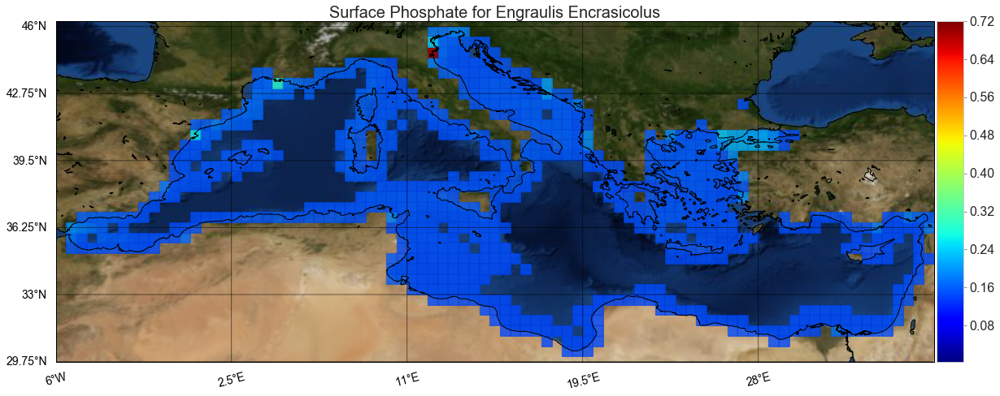

In [87]:
plot_map(data,'phosphateSurface','Surface Phosphate for '+speciesName)

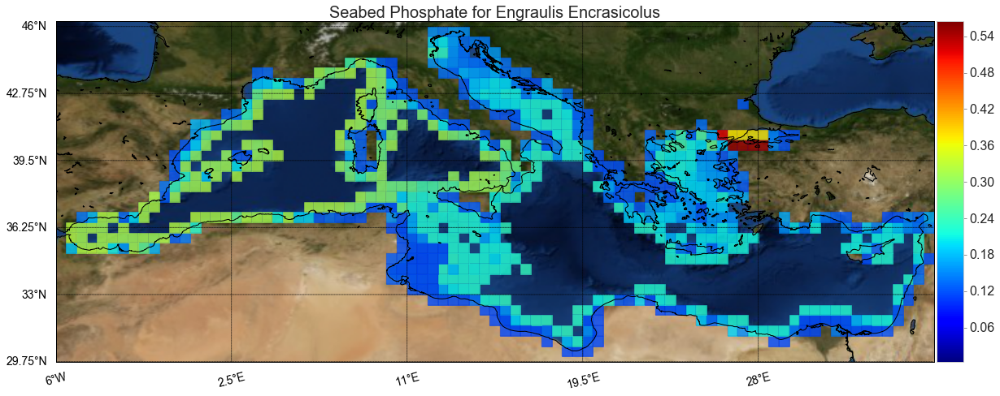

In [88]:
plot_map(data,'phosphateMaxDepth','Seabed Phosphate for '+speciesName)

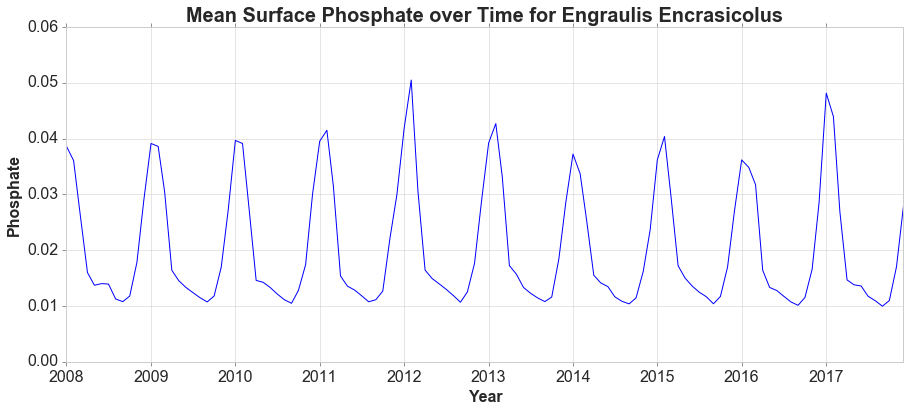

In [89]:
time_plot(data_perYearMonth,'phosphateSurface','Mean Surface Phosphate over Time for '+speciesName,'Phosphate')

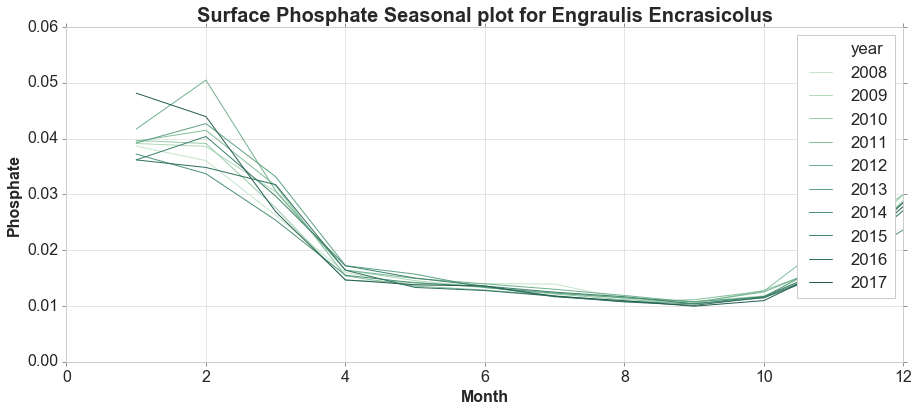

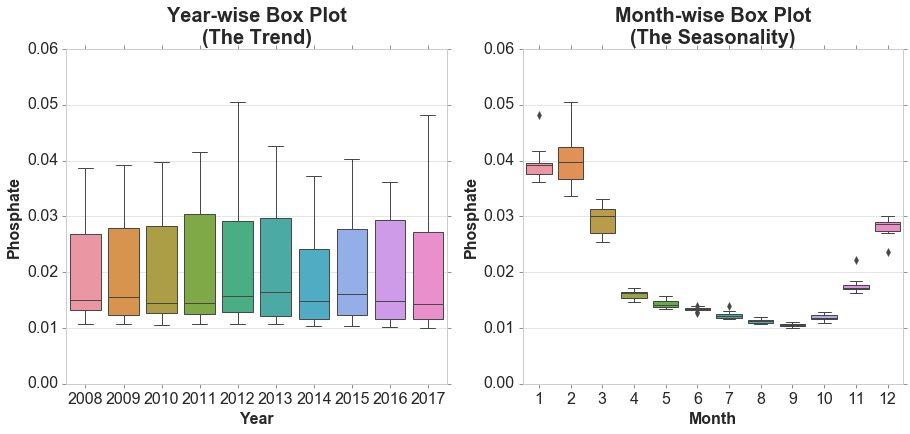

In [90]:
seasonality_plot(data_perYearMonth,'phosphateSurface','Surface Phosphate Seasonal plot for '+speciesName,'Phosphate')

Trend strength: 0.2109634276267487
Seasonality strength: 0.9723551384469759
Augmented Dickey-Fuller Test: 
ADF test statistic       -1.617426
p-value                   0.474079
# lags used              11.000000
# observations          108.000000
critical value (1%)      -3.492401
critical value (10%)     -2.581255
critical value (5%)      -2.888697
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


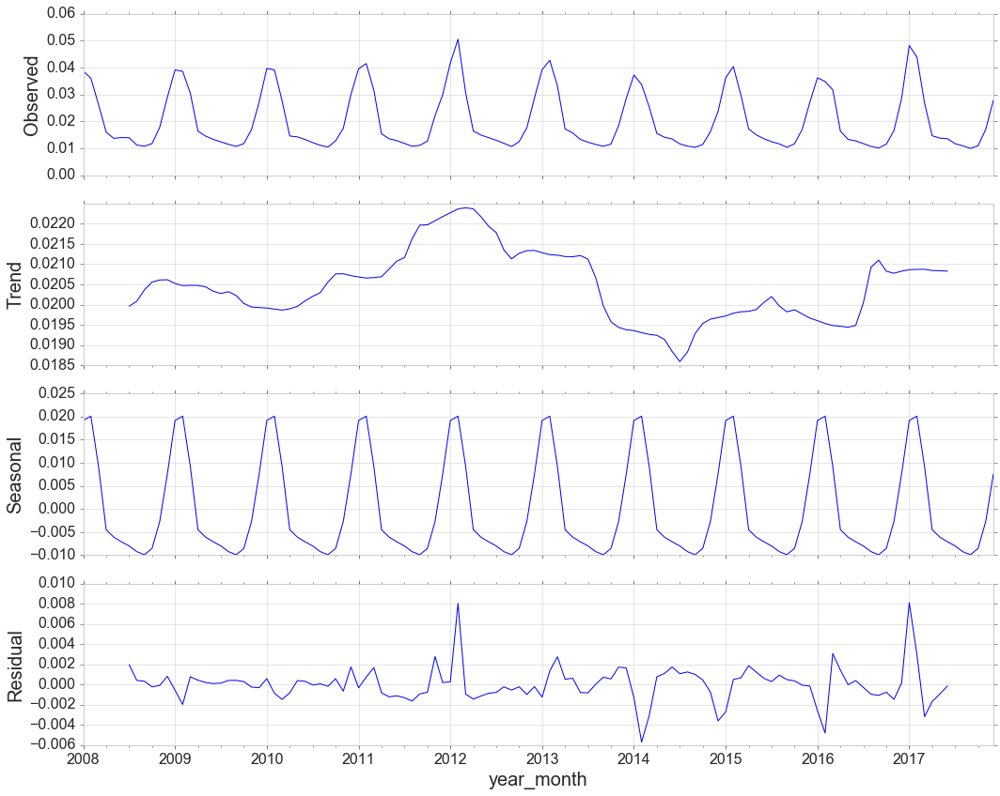

In [91]:
decomposition(data_perYearMonth,'phosphateSurface')
adf_test(data_perYearMonth['phosphateSurface'])

# Distance to Coast

In [92]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'distanceToCoast' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
1 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
1 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
distanceToCoast,float64,729,10.703604,0.137174,2.978528,12.667254,25.710061,0.046582,7.827065,17.315492,31.365613,252.459628,0,0.0


In [93]:
plot_univariate(data['distanceToCoast'], speciesName+' Distance to Coast')

In [94]:
plot_univariate(data[data['Overall Probability']>=0.8]['distanceToCoast'], 'High Probability '+speciesName+' Distance to Coast')

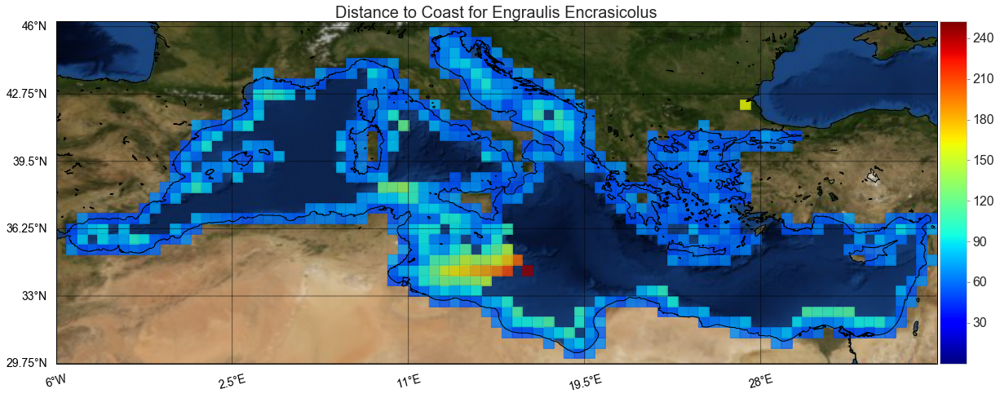

In [95]:
plot_map(data,'distanceToCoast','Distance to Coast for '+speciesName)

# Distance to Major River

In [96]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'majorRiverDistance' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
1 columns are highly positively skewed (skewness>1), while 0 columns are highly negatively skewed (skewness<-1).
1 columns are symmetrical (-0.5<skewness<0.5).
0 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 1 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
majorRiverDistance,float64,729,370.356214,0.137174,1.016067,0.135087,377.219969,20.069816,182.724465,290.961667,522.450782,1140.79994,0,0.0


In [97]:
plot_univariate(data['majorRiverDistance'], speciesName+' Distance to Major River')

In [98]:
plot_univariate(data[data['Overall Probability']>=0.8]['majorRiverDistance'], 'High Probability '+speciesName+' Distance to Major River')

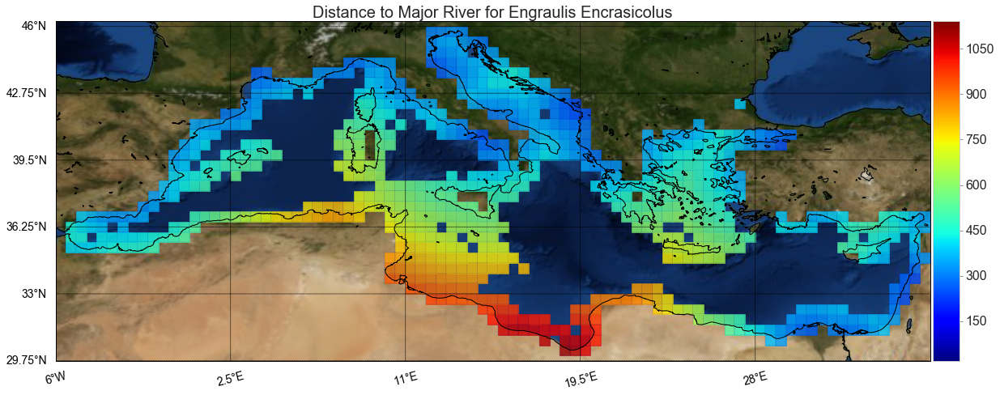

In [99]:
plot_map(data,'majorRiverDistance','Distance to Major River for '+speciesName)

In [100]:
data_majorRiversScale = data['majorRiversScale'].value_counts().to_frame().reset_index()
data_majorRiversScale.iplot(kind='pie',labels=['index'], values='majorRiversScale', pull=0.02, hole=0.2, title='Major River Scales for '+speciesName+' Observations')

# Bathymetry

In [101]:
get_stats(data, sort_by='Mean', sort_how=False, include_only=[c for c in data if 'bathymetry' in c])

Your selected dataframe has 1 columns. (0 categorical and 1 numerical).
There are 0 columns that have missing values, of which 0 have over 90%!
0 object type columns have less than 5 different values and you can consider one-hot encoding, while 0 have more than 5 colums and you can consider label encoding.
0 columns are highly positively skewed (skewness>1), while 1 columns are highly negatively skewed (skewness<-1).
0 columns are symmetrical (-0.5<skewness<0.5).
1 columns have high kurtosis (kurtosis>3) and should be check for outliers, while 0 columns have low kurtosis (kurtosis<3). 


,Type,Different Values,Most Common,% of Most Common,Skewness,Kurtosis,Mean,Min,25% quantile,Median,75% quantile,Max,Missing Values,% of Missing Values
Name,,,,,,,,,,,,,,
bathymetry,float64,701,0.0,2.057613,-1.964257,3.773479,-433.986848,-3549.76,-609.104981,-134.417007,-31.0168,0.0,0,0.0


In [102]:
plot_univariate(data['bathymetry'], speciesName+' Bathymetry')

In [103]:
plot_univariate(data[data['Overall Probability']>=0.8]['bathymetry'], speciesName+' Bathymetry')

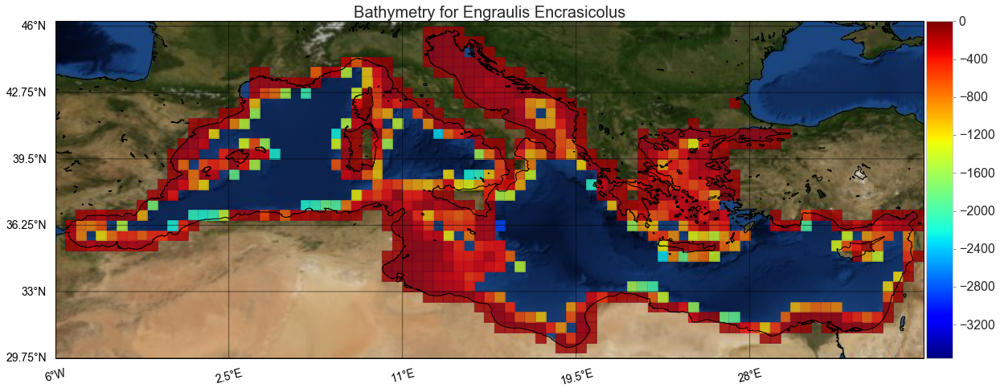

In [104]:
plot_map(data,'bathymetry','Bathymetry for '+speciesName)

# Substrate

In [105]:
data_substrateType = data['substrateType'].value_counts().to_frame().reset_index()
data_substrateType.iplot(kind='pie',labels=['index'], values='substrateType', pull=0.02, hole=0.2, title='Substrate Type for '+speciesName+' Observations')

In [107]:
data_substrateBiozone = data['substrateBiozone'].value_counts().to_frame().reset_index()
data_substrateBiozone.iplot(kind='pie',labels=['index'], values='substrateBiozone', pull=0.02, hole=0.2, title='Substrate Biozone for '+speciesName+' Observations')

In [108]:
data_substrateOrigHabitat = data['substrateOrigHabitat'].value_counts().to_frame().reset_index()
data_substrateOrigHabitat['index'] = data_substrateOrigHabitat['index'].apply(lambda x: re.sub(r'.*: ', '', x))
data_substrateOrigHabitat['index'] = data_substrateOrigHabitat['index'].apply(lambda x: x.replace('moderately exposed to or sheltered from hydrodynamic action',''))
data_substrateOrigHabitat.iplot(kind='pie',textposition='inside',labels=['index'], values='substrateOrigHabitat', pull=0.02, hole=0.2, title='Substrate Biozone for '+speciesName+' Observations')

# Overall Probability

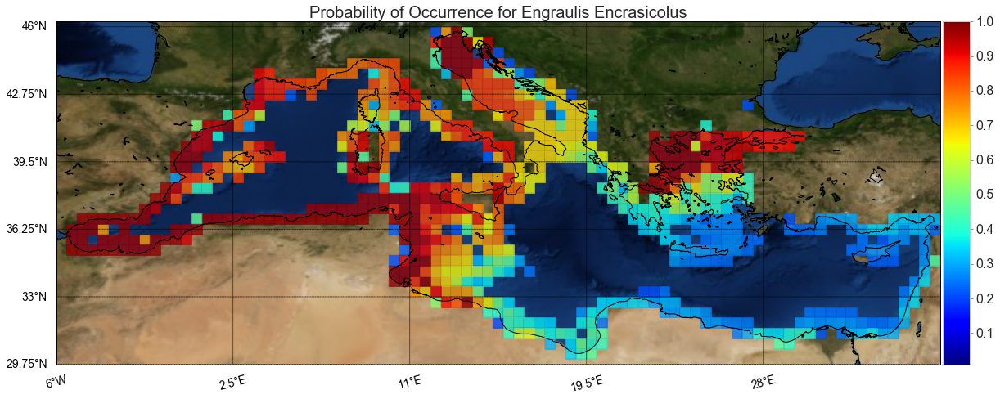

In [109]:
plot_map(data,'Overall Probability','Probability of Occurrence for '+speciesName)

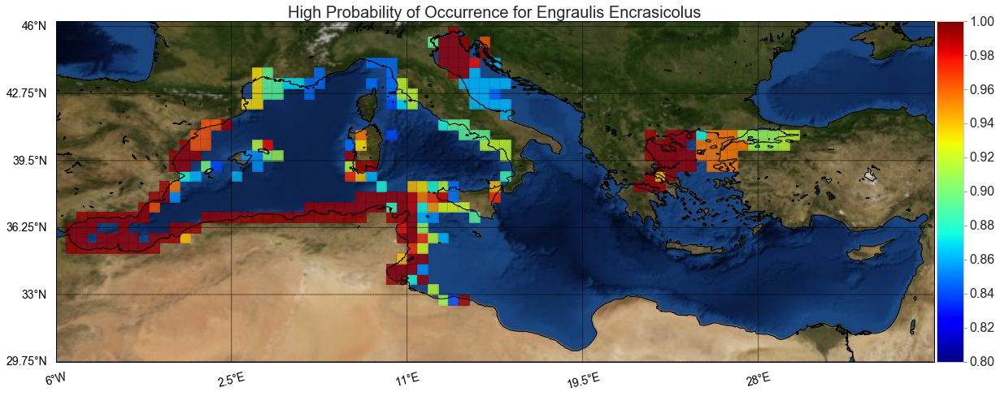

In [110]:
plot_map(data[data['Overall Probability']>=0.8],'Overall Probability','High Probability of Occurrence for '+speciesName)

# Correlations

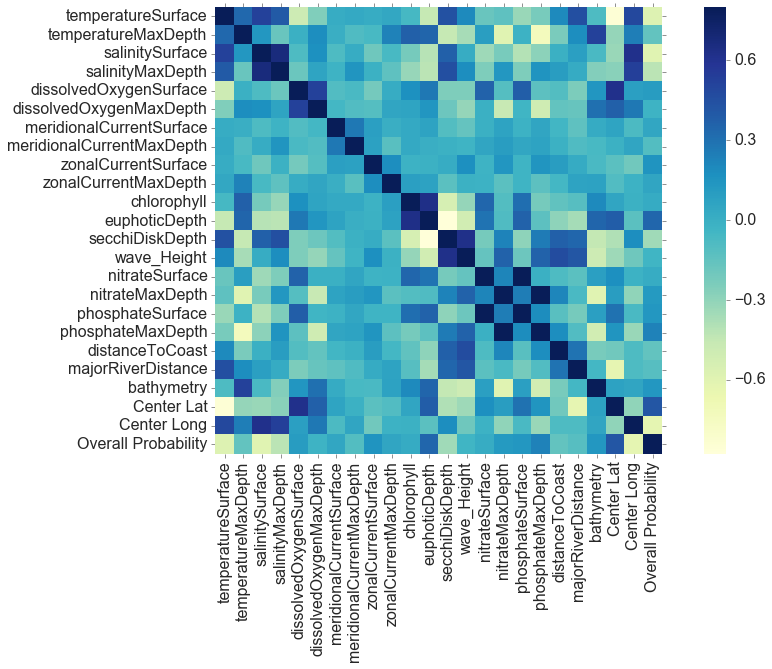

In [111]:
cols_for_correlation = ['temperatureSurface','temperatureMaxDepth','salinitySurface','salinityMaxDepth','dissolvedOxygenSurface','dissolvedOxygenMaxDepth','meridionalCurrentSurface','meridionalCurrentMaxDepth','zonalCurrentSurface','zonalCurrentMaxDepth','chlorophyll','euphoticDepth','secchiDiskDepth','wave_Height','nitrateSurface','nitrateMaxDepth','phosphateSurface','phosphateMaxDepth','distanceToCoast','majorRiverDistance','bathymetry','Center Lat','Center Long','Overall Probability']
corrmat = data[cols_for_correlation].corr()
fig, ax = plt.subplots(figsize=(15,8))
sns.heatmap(corrmat, vmax=.8, square=True, cmap="YlGnBu");

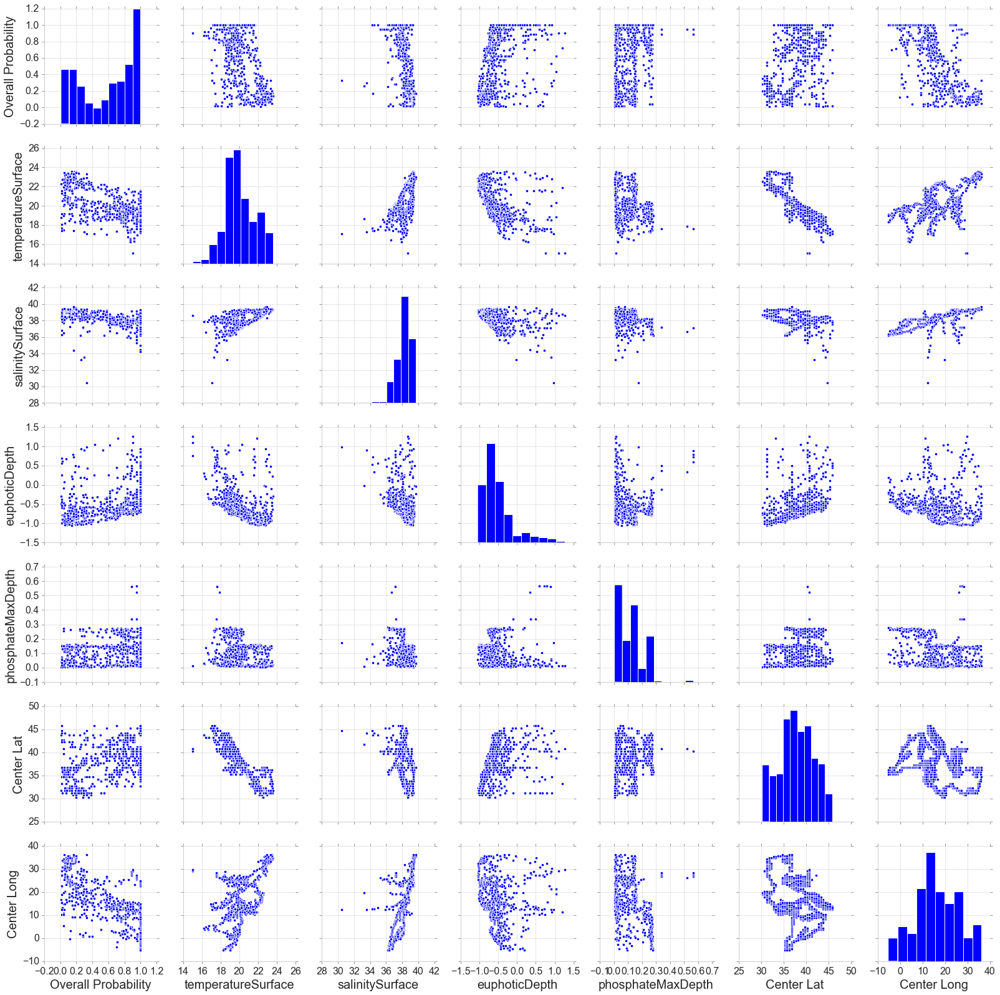

In [112]:
cols = ['Overall Probability','temperatureSurface','salinitySurface','euphoticDepth', 'phosphateMaxDepth', 'Center Lat', 'Center Long']
sns.pairplot(data[cols], height = 3.2);